In [43]:
import warnings
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", RuntimeWarning)

import sys
sys.path.append('../../dstorch/')

import pandas as pd
import seaborn
import matplotlib.pyplot as plt
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [2]:
from dstorch import io, dataset, transforms, losses, models, predict, draw, utils
from dstorch.train import train
from dstorch.utils import variable
import torch.backends.cudnn as cudnn
import torch
import torch.nn as nn
from torch.optim import Adam
from tqdm import tqdm_notebook, tqdm
import numpy as np
import cv2
import skimage
import os
from skimage.io import imread

In [3]:
classes = pd.read_csv("../../classes.csv")

TRAIN_PATH = '../../kaggle-dsbowl-2018-dataset-fixes/stage1_train/'
TEST_PATH = '../../stage1_test/'

ids = next(os.walk(TRAIN_PATH))[1]
[train_ids], [val_ids] = utils.train_val_split(classes, ids, ids)

In [4]:
train_transform = transforms.DualCompose(
    [
        transforms.RandomCrop((256, 256)),
        transforms.VerticalFlip(),
        transforms.HorizontalFlip(),
        transforms.Transpose(),
        transforms.ShiftScaleRotate(scale_limit=0.75, prob=1),
        transforms.Distort1(0.5, 0.5),
        transforms.ImageOnly(transforms.RandomBrightness(0.5)),
        transforms.ImageOnly(transforms.RandomContrast(0.5)),
        transforms.ImageOnly(transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]
        ))
    ]
)

val_transform = transforms.DualCompose(
    [
        transforms.ImageOnly(transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225]))
    ]
)

train_loader = dataset.make_loader(
    train_ids, "../../data/images/{}.png", "../../data/masks/{}.png", 16, 
    transform=train_transform, period=64
)

val_loader = dataset.make_loader(
    val_ids, "../../data/images/{}.png", "../../data/masks/{}.png", 1, 
    transform=val_transform, shuffle=False, mode='validation', period=64
)

In [5]:
model = models.TernausNet34(num_classes=3, num_filters=16, pretrained=True)
loss = losses.BCEDiceLossCenter()

if torch.cuda.is_available():
    model = nn.DataParallel(model).cuda()
    cudnn.benchmark = True

train(
    init_optimizer=lambda lr: Adam(model.parameters(), lr=lr),
    model=model,
    criterion=loss,
    train_loader=train_loader,
    val_loader=val_loader,
    n_epochs=50, 
    batch_size=16,
    lr=0.0005
)

train(
    init_optimizer=lambda lr: Adam(model.parameters(), lr=lr),
    model=model,
    criterion=loss,
    train_loader=train_loader,
    val_loader=val_loader,
    n_epochs=50, 
    batch_size=16,
    lr=0.0001
)

In [6]:
train(
    init_optimizer=lambda lr: Adam(model.parameters(), lr=lr),
    model=model,
    criterion=loss,
    train_loader=train_loader,
    val_loader=val_loader,
    n_epochs=50, 
    batch_size=16,
    lr=0.0005
)

Epoch 2, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.70119


Epoch 2, lr 0.0005: : 597it [00:10, 58.58it/s, loss=0.52057]                       
Epoch 3, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.64883


Epoch 3, lr 0.0005: : 597it [00:10, 58.52it/s, loss=0.50672]                       
Epoch 4, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.54884


Epoch 4, lr 0.0005: : 597it [00:10, 58.41it/s, loss=0.46344]                       
Epoch 5, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.52646


Epoch 5, lr 0.0005: : 597it [00:10, 57.73it/s, loss=0.39661]                       
Epoch 6, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.52652


Epoch 6, lr 0.0005: : 597it [00:10, 56.46it/s, loss=0.37846]                       
Epoch 7, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.40513


Epoch 7, lr 0.0005: : 597it [00:10, 55.74it/s, loss=0.43050]                       
Epoch 8, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.44842


Epoch 8, lr 0.0005: : 597it [00:10, 55.49it/s, loss=0.41932]                       
Epoch 9, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.36874


Epoch 9, lr 0.0005: : 597it [00:10, 55.68it/s, loss=0.39768]                       
Epoch 10, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.36008


Epoch 10, lr 0.0005: : 597it [00:10, 55.58it/s, loss=0.34545]                       
Epoch 11, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.36553


Epoch 11, lr 0.0005: : 597it [00:10, 55.71it/s, loss=0.37320]                       
Epoch 12, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.31826


Epoch 12, lr 0.0005: : 597it [00:10, 55.45it/s, loss=0.34009]                       
Epoch 13, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.30801


Epoch 13, lr 0.0005: : 597it [00:10, 55.69it/s, loss=0.31467]                       
Epoch 14, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.30906


Epoch 14, lr 0.0005: : 597it [00:10, 55.70it/s, loss=0.33580]                       
Epoch 15, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.30069


Epoch 15, lr 0.0005: : 597it [00:10, 55.59it/s, loss=0.34019]                       
Epoch 16, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.35134


Epoch 16, lr 0.0005: : 597it [00:10, 55.54it/s, loss=0.39142]                       
Epoch 17, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.28306


Epoch 17, lr 0.0005: : 597it [00:10, 55.54it/s, loss=0.32169]                       
Epoch 18, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.28580


Epoch 18, lr 0.0005: : 597it [00:10, 55.49it/s, loss=0.35135]                       
Epoch 19, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.29286


Epoch 19, lr 0.0005: : 597it [00:10, 55.67it/s, loss=0.30366]                       
Epoch 20, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.31488


Epoch 20, lr 0.0005: : 597it [00:10, 55.65it/s, loss=0.30126]                       
Epoch 21, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.27335


Epoch 21, lr 0.0005: : 597it [00:10, 55.57it/s, loss=0.34773]                       
Epoch 22, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.31262


Epoch 22, lr 0.0005: : 597it [00:10, 55.59it/s, loss=0.33064]                       
Epoch 23, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.27119


Epoch 23, lr 0.0005: : 597it [00:10, 55.61it/s, loss=0.36990]                       
Epoch 24, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.31212


Epoch 24, lr 0.0005: : 597it [00:10, 55.66it/s, loss=0.34049]                       
Epoch 25, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.38713


Epoch 25, lr 0.0005: : 597it [00:10, 55.65it/s, loss=0.34523]                       
Epoch 26, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.32646


Epoch 26, lr 0.0005: : 597it [00:10, 55.62it/s, loss=0.33849]                       
Epoch 27, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.24595


Epoch 27, lr 0.0005: : 597it [00:10, 55.53it/s, loss=0.31029]                       
Epoch 28, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.29803


Epoch 28, lr 0.0005: : 597it [00:10, 55.57it/s, loss=0.26967]                       
Epoch 29, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.27321


Epoch 29, lr 0.0005: : 597it [00:10, 55.57it/s, loss=0.27917]                       
Epoch 30, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.23346


Epoch 30, lr 0.0005: : 597it [00:10, 55.67it/s, loss=0.27963]                       
Epoch 31, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.23379


Epoch 31, lr 0.0005: : 597it [00:10, 55.67it/s, loss=0.30821]                       
Epoch 32, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.23589


Epoch 32, lr 0.0005: : 597it [00:10, 55.62it/s, loss=0.32830]                       
Epoch 33, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.44844


Epoch 33, lr 0.0005: : 597it [00:10, 55.70it/s, loss=0.31463]                       
Epoch 34, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.24334


Epoch 34, lr 0.0005: : 597it [00:10, 55.67it/s, loss=0.32209]                       
Epoch 35, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.48417


Epoch 35, lr 0.0005: : 597it [00:10, 55.58it/s, loss=0.28404]                       
Epoch 36, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.31544


Epoch 36, lr 0.0005: : 597it [00:10, 55.55it/s, loss=0.32186]                       
Epoch 37, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.26543


Epoch 37, lr 0.0005: : 597it [00:10, 55.73it/s, loss=0.30549]                       
Epoch 38, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.24108


Epoch 38, lr 0.0005: : 597it [00:10, 56.81it/s, loss=0.33603]                       
Epoch 39, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.24477


Epoch 39, lr 0.0005: : 597it [00:10, 55.72it/s, loss=0.30198]                       
Epoch 40, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.32320


Epoch 40, lr 0.0005: : 597it [00:10, 55.67it/s, loss=0.26161]                       
Epoch 41, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.25402


Epoch 41, lr 0.0005: : 597it [00:10, 55.62it/s, loss=0.27554]                       
Epoch 42, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.27335


Epoch 42, lr 0.0005: : 597it [00:10, 55.56it/s, loss=0.32321]                       
Epoch 43, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.25742


Epoch 43, lr 0.0005: : 597it [00:10, 55.67it/s, loss=0.25411]                       
Epoch 44, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.27780


Epoch 44, lr 0.0005: : 597it [00:10, 55.60it/s, loss=0.24430]                       
Epoch 45, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.30718


Epoch 45, lr 0.0005: : 597it [00:10, 55.62it/s, loss=0.27193]                       
Epoch 46, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.23273


Epoch 46, lr 0.0005: : 597it [00:10, 55.67it/s, loss=0.24574]                       
Epoch 47, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.21681


Epoch 47, lr 0.0005: : 597it [00:10, 55.68it/s, loss=0.26352]                       
Epoch 48, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.25700


Epoch 48, lr 0.0005: : 597it [00:10, 55.54it/s, loss=0.26091]                       
Epoch 49, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.29731


Epoch 49, lr 0.0005: : 597it [00:10, 55.55it/s, loss=0.29128]                       
Epoch 50, lr 0.0005:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.27068


Epoch 50, lr 0.0005: : 597it [00:10, 55.77it/s, loss=0.27001]                       


Valid loss: 0.21727


In [369]:
torch.save({
        'model': model.state_dict()
    }, str('../../models/loss_0466.pt'))

In [44]:
test_ids = list(classes.loc[classes['type'] == 'test', 'id'])

In [45]:
val_transform = transforms.DualCompose(
    [
        transforms.ImageOnly(transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]))
    ]
)

val_predictions, val_names = predict.predict(model, val_ids, "../../data/images/{}.png", val_transform, 1, 2)

Predict: 100%|██████████| 67/67 [00:05<00:00, 12.89it/s]


In [9]:
val_images = []
for _id in tqdm(val_names):
    val_images.append(cv2.imread("../../data/images/{}.png".format(_id)))

val_masks = []
for _id in tqdm(val_names):
    val_masks.append(cv2.imread("../../data/masks/{}.png".format(_id)))

100%|██████████| 67/67 [00:00<00:00, 559.06it/s]


In [10]:
rles = pd.read_csv("../../stage1_train_labels.csv")
val_labels = utils.rles2labels(rles, [x[..., 0].shape for x in val_masks], val_names)

100%|██████████| 67/67 [00:02<00:00, 32.12it/s]


In [46]:
import cv2
import numpy as np
import scipy.ndimage as nd
from skimage import img_as_bool, img_as_ubyte
from skimage import morphology
from skimage.feature import peak_local_max
from skimage.filters import gaussian


def remove_smalls(mask, width_holes, width_objects):
    remove_holes = morphology.remove_small_holes(
        mask.astype(bool),
        min_size=width_holes ** 3
    )
    
    remove_objects = morphology.remove_small_objects(
        remove_holes.astype(bool),
        min_size=width_objects ** 3
    )
    return remove_holes, remove_objects


def distance_transform(mask, sigma):
    distance = nd.distance_transform_edt(mask)
    distance = gaussian(distance, sigma=sigma)
    return distance


def pad_zero(image, padding_size, padding=True):
    h, w = image.shape
    if padding:
        padded_image = np.zeros((h + 2 * padding_size, w + 2 * padding_size), dtype=image.dtype)
        padded_image[padding_size:padding_size + h, padding_size:padding_size + w] = image
        return padded_image
    else:
        return image[padding_size:-padding_size, padding_size:-padding_size]


def watershed(
        prediction,
        mask_threshold=0.7,
        center_threshold=0.7,
        width_holes=4,
        width_objects=3,
        sigma=3,
        padding_size=5,
        min_size=50,
        footprint=np.ones((3, 3))
):
    pred_mask, pred_center_1, pred_center  = prediction[..., 0], prediction[..., 1], prediction[..., 2]
    mask = img_as_ubyte(pred_mask > mask_threshold)
    center = img_as_ubyte(pred_center > center_threshold)
    _, mask = remove_smalls(mask, width_holes, width_objects)
    
    padded_distance = pad_zero(distance_transform(center, sigma=sigma), 
                               padding_size=padding_size)
    
    markers = nd.label(pad_zero(center, 5))[0]
    
    watershed_image = pad_zero(
        morphology.watershed(-pad_zero(pred_mask, padding_size=padding_size), 
        markers, mask=pad_zero(mask, padding_size=padding_size)),
        padding_size=padding_size, padding=False
    )
    
    unique, counts = np.unique(watershed_image, return_counts=True)
    for (k, v) in dict(zip(unique, counts)).items():
        if v < min_size:
            watershed_image[watershed_image == k] = 0
    return watershed_image


def get_labels(labeled_image):
    labels = []
    for i in np.unique(labeled_image):
        if i:
            mask = labeled_image == i
            labels.append(mask)
    return np.array(labels)

In [47]:
import numpy as np
import tensorflow as tf
from keras import backend as K
from keras.losses import binary_crossentropy
from tqdm import tqdm_notebook
from collections import defaultdict

def get_ious(y_true, y_pred):
    ious = []
    for prediction in y_pred:
        max_intersection = 0
        max_union = 1e-9
        for ground_truth in y_true:
            intersection = np.sum(prediction * ground_truth)
            if intersection > max_intersection:
                max_intersection = intersection
                max_union = np.sum(np.maximum(prediction, ground_truth))
        ious.append(max_intersection / max_union)
    return ious

def local_mean_iou(y_true, y_pred):
    p = 0
    num_true, num_pred = len(y_true), len(y_pred)

    ious = get_ious(y_true, y_pred)
    for t in np.arange(0.5, 1.0, 0.05):
        matches = ious > t
        tp = np.count_nonzero(matches)
        fp = num_pred - tp
        fn = num_true - tp
        p += tp / (tp + fp + fn)
    return p / 10


def get_scores(gt_labels, name2predictions):
    name2scores = defaultdict(list)
    for i, gt_label in tqdm_notebook(enumerate(gt_labels), total=len(gt_labels)):
        for name, pred in name2predictions.items():
            score = local_mean_iou(gt_label, pred[i])
            name2scores[name].append(score)
            print("{}: {}: {}, mean: {}".format(i, name, score, np.mean(name2scores[name])))
    return name2scores

0.4067292745143831 0.406729274514


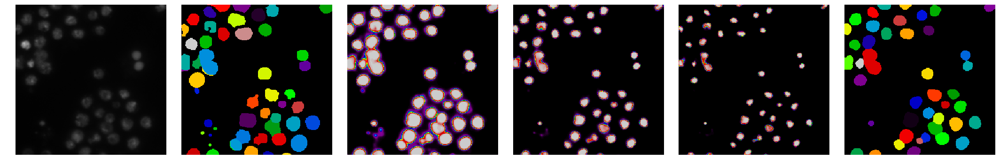

0.8916666666666666 0.649197970591


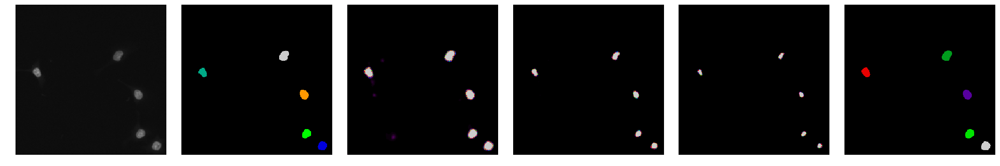

0.836111111111111 0.711502350764


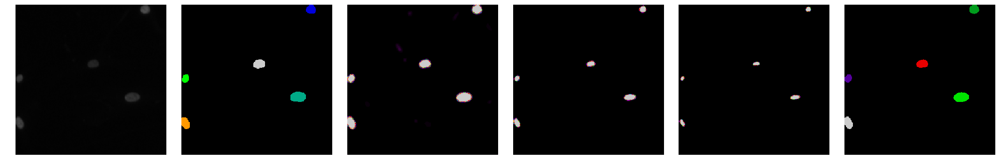

0.43827806014047227 0.643196278108


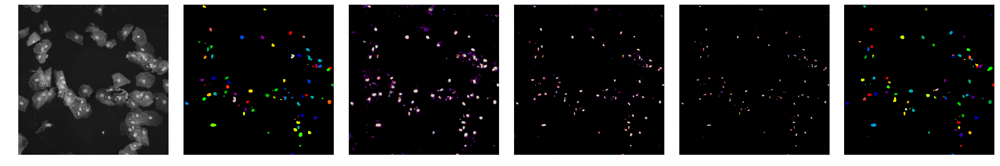

0.7859615384615385 0.671749330179


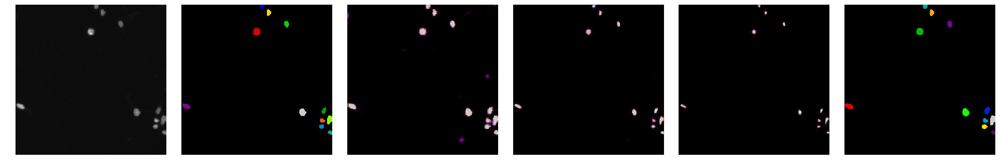

0.8015403726708072 0.693381170594


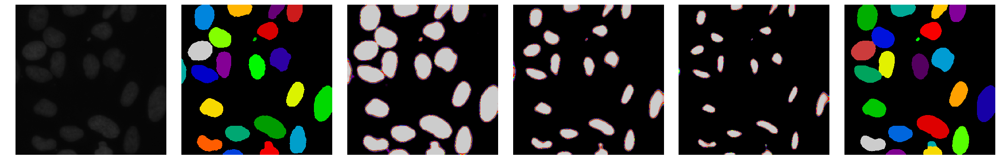

0.46218403703716293 0.660353008657


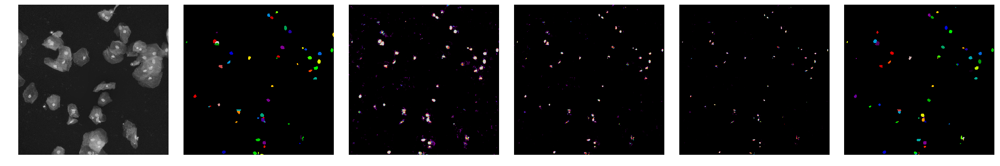

0.8138528138528139 0.679540484307


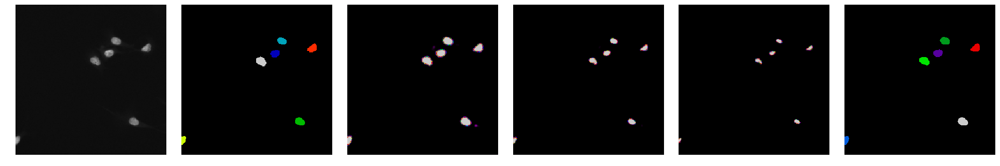

0.3631289681726939 0.644383649181


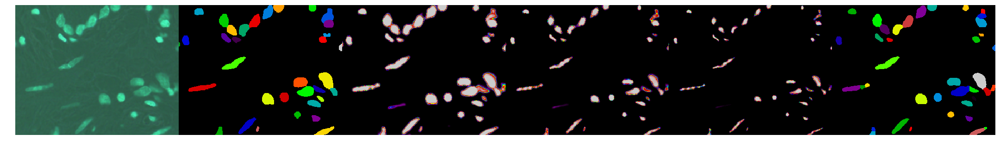

0.8723236184105749 0.667177646104


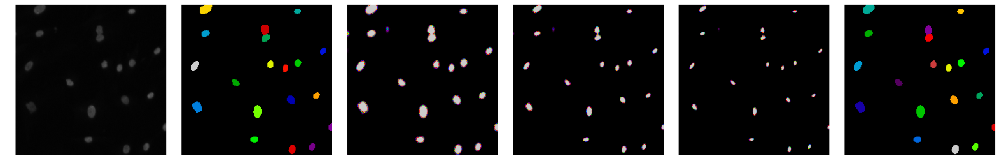

0.14297643097643095 0.619522990183


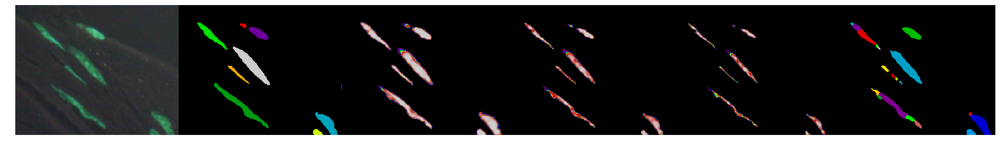

0.816696855701512 0.635954145643


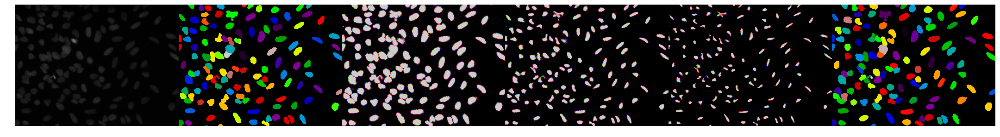

0.9393939393939394 0.659295668239


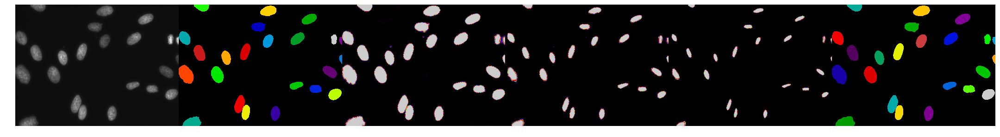

0.41573288719970974 0.641898326736


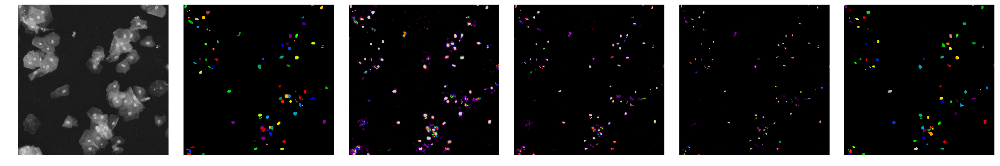

0.5950894158971285 0.63877773268


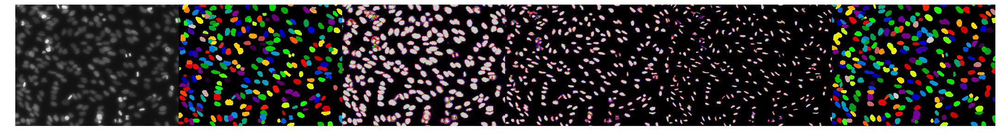

0.3109186069465528 0.618286537322


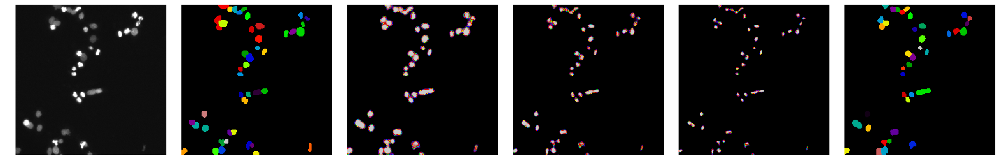

0.5540290643551514 0.614506685971


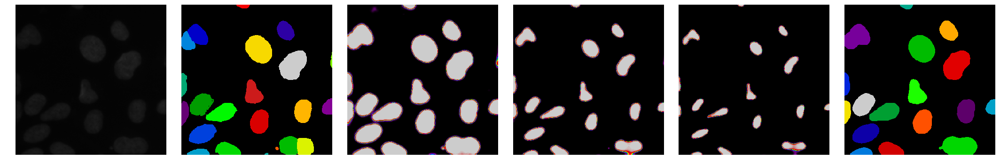

0.16015407169446788 0.589264874067


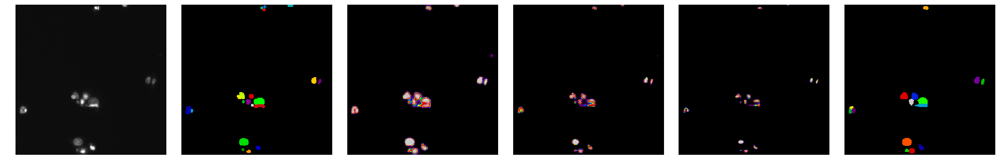

0.25575757575757574 0.571711858366


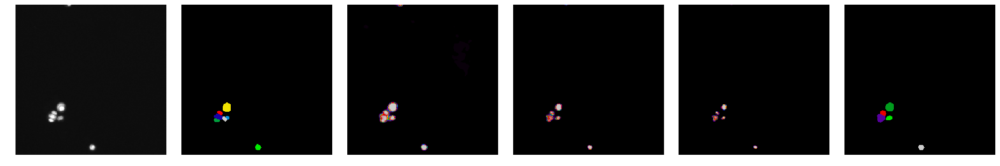

0.39036796536796536 0.562644663716


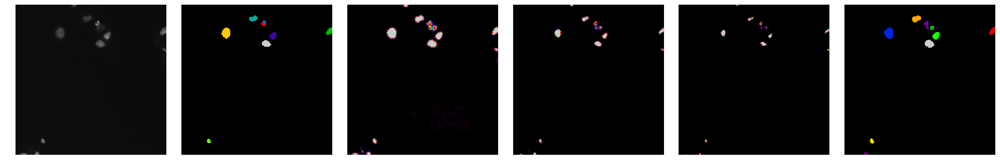

0.49202836349473983 0.559281982753


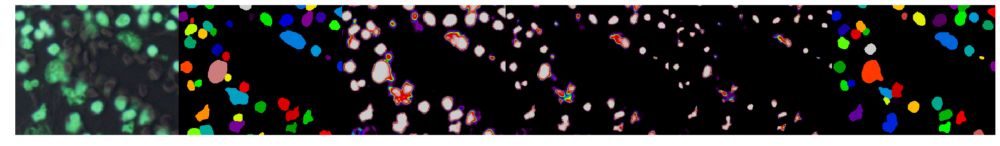

0.7375 0.567382801719


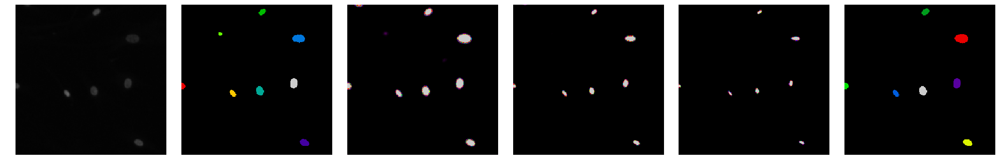

0.3120863742778406 0.556282957048


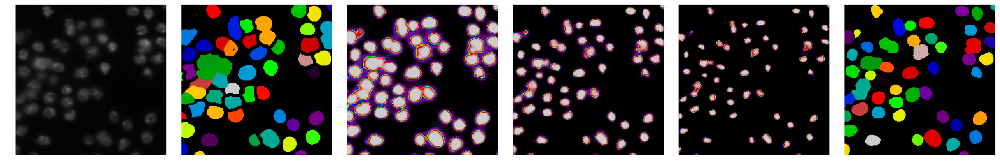

0.6840336134453782 0.561605901064


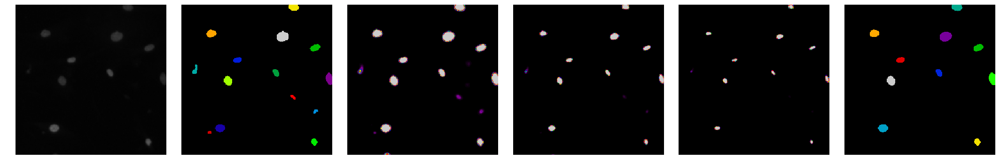

0.8645588235294118 0.573724017963


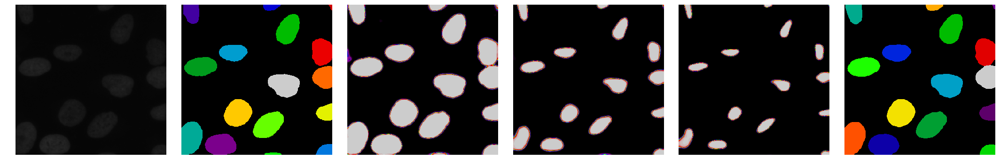

0.8206788766788767 0.58322228176


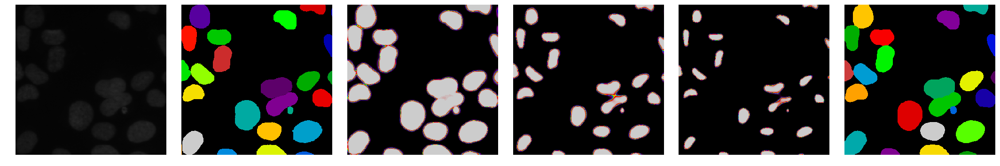

0.6276154294383174 0.584866472415


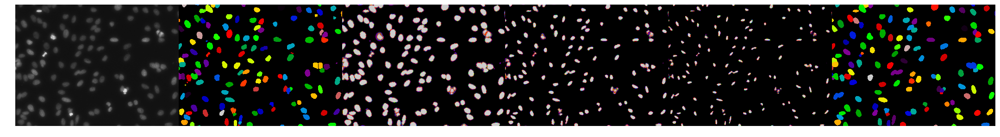

0.3225919281944241 0.575499524407


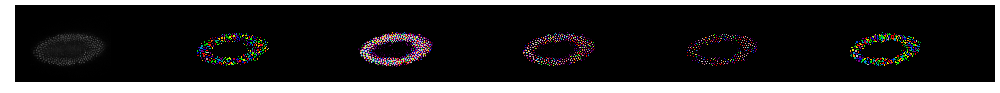

0.33471546306397315 0.56719662574


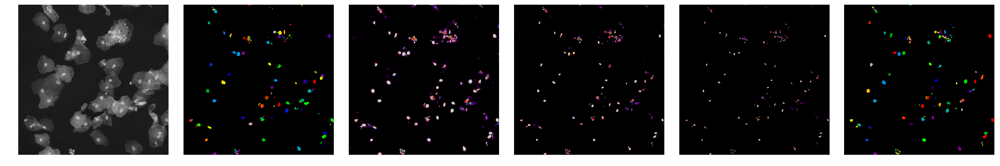

0.7961363636363636 0.574827950336


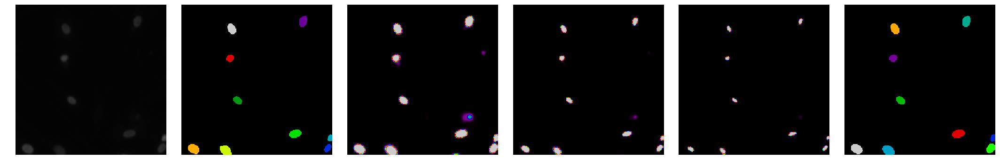

0.7887066365007541 0.581727262793


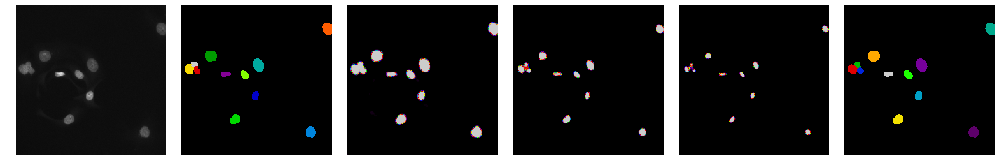

0.2239420804441127 0.570546475845


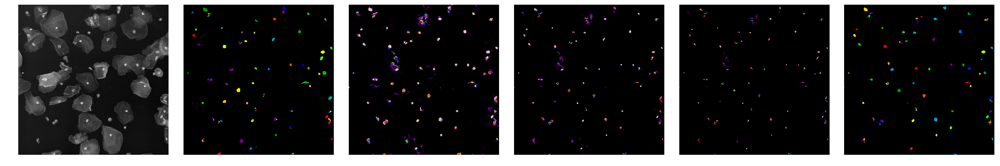

0.96 0.582348097789


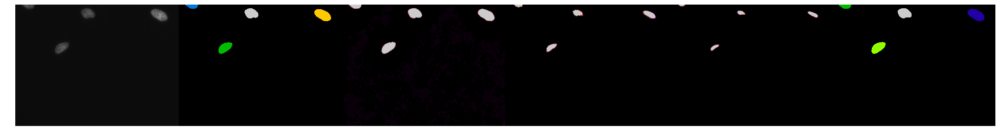

0.514806503979891 0.580361580324


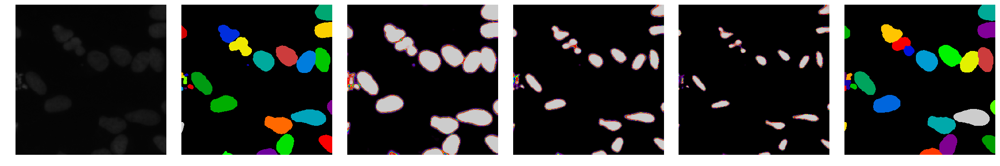

0.502704678362573 0.578142811696


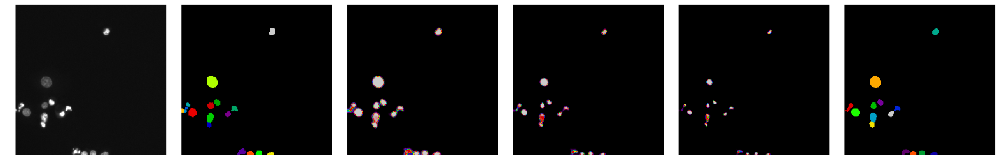

0.8034291704103025 0.584400766105


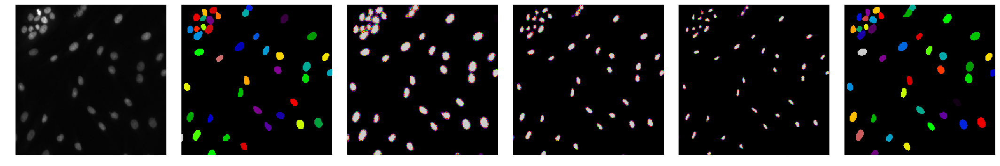

0.7877056277056277 0.589895492094


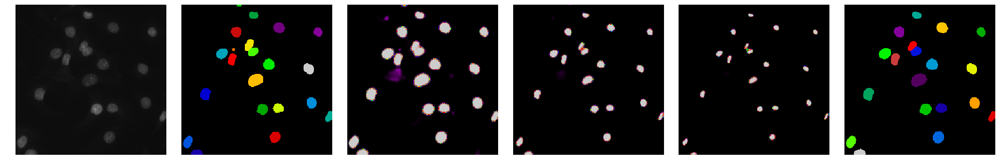

0.8648627450980392 0.597131472437


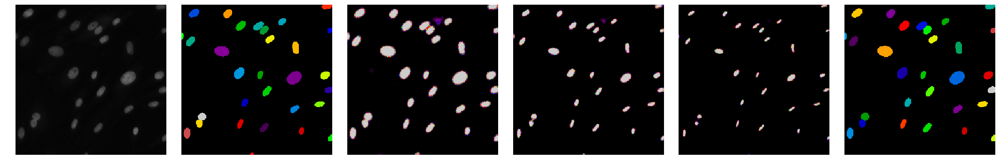

0.810869372562921 0.602611931414


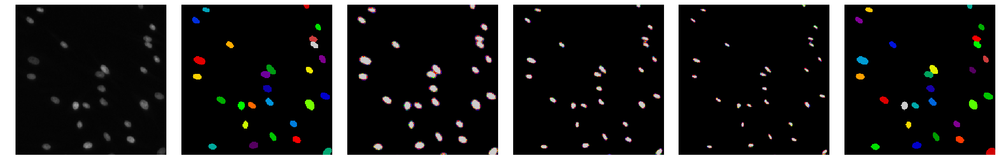

0.4974186259270055 0.599982098777


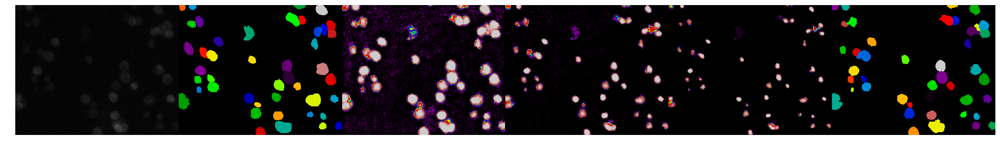

0.643331390072267 0.601039398565


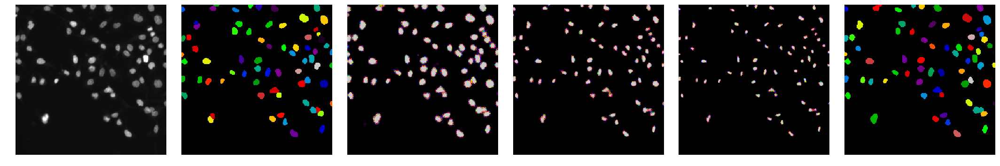

0.788818310143174 0.605510325031


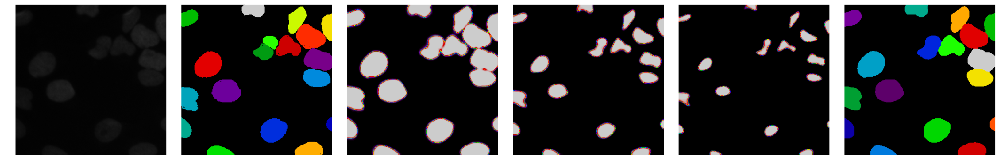

0.690051282051282 0.607476393799


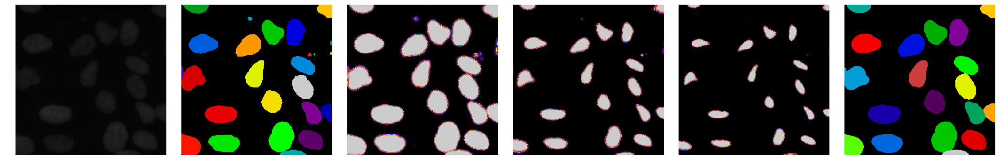

0.8880952380952382 0.613854094805


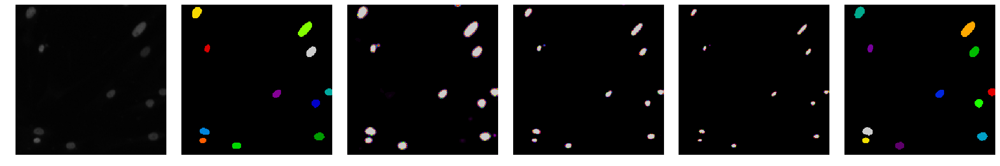

0.8550159489633173 0.61921324712


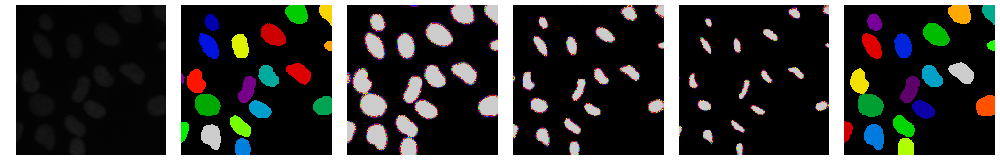

0.6670454545454547 0.620253077716


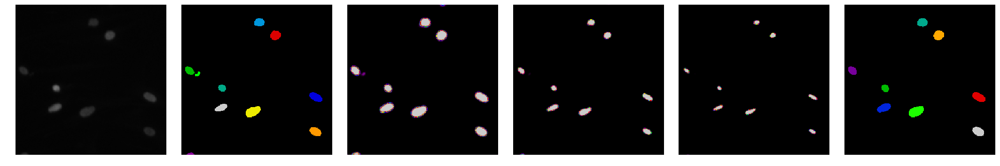

0.9846153846153847 0.628005467225


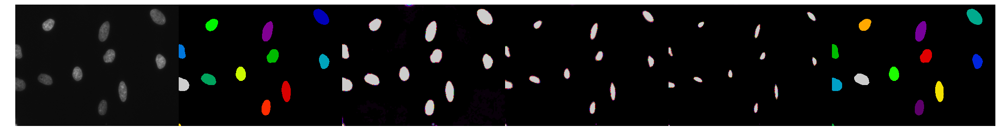

0.4390934435524992 0.624069800065


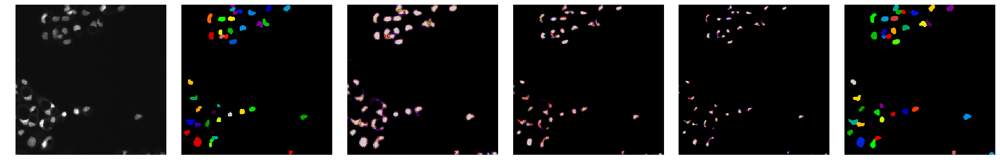

0.35871111345705964 0.618654316665


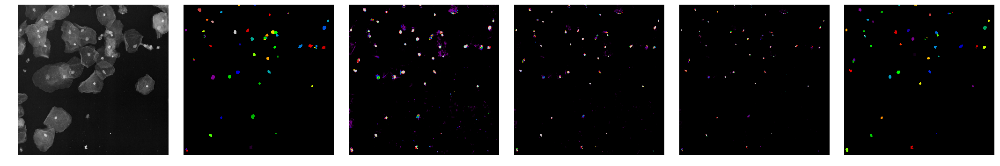

0.640650623885918 0.619094242809


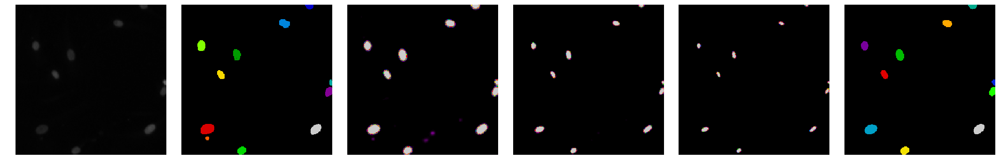

0.8375 0.623376708636


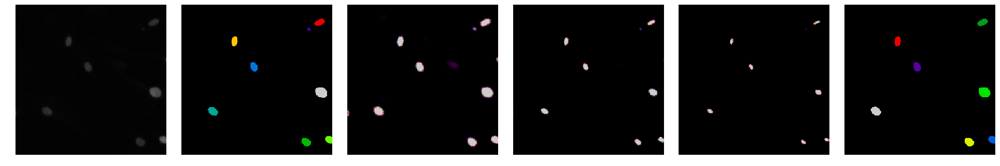

0.9067307692307691 0.628825825186


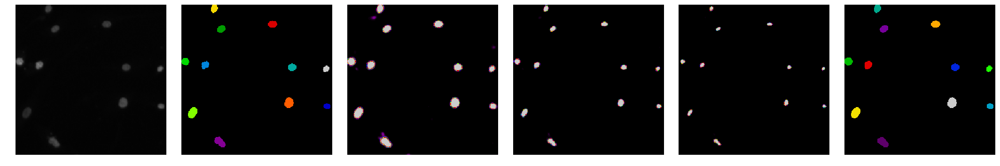

0.2830467811758134 0.622301692281


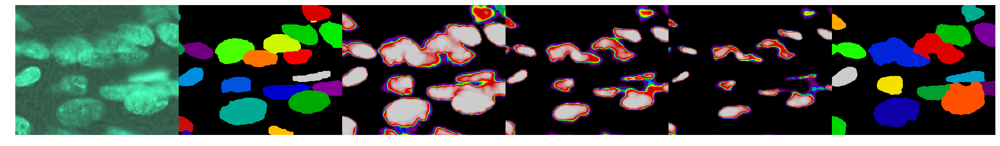

0.5348700398845276 0.620682587607


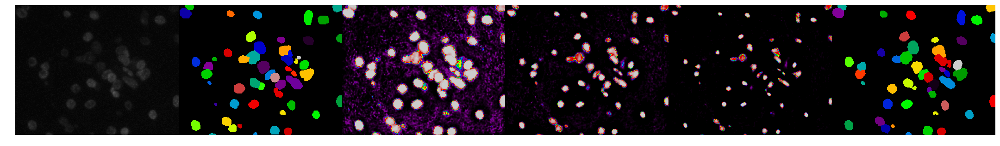

0.3229999791007082 0.615270176543


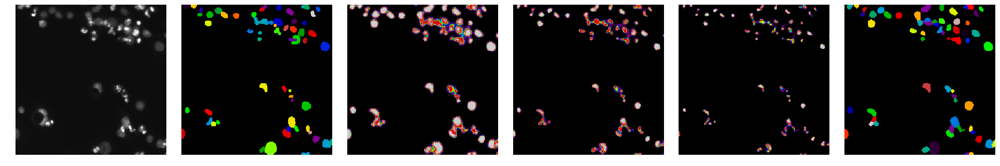

0.32342203547135107 0.610058602595


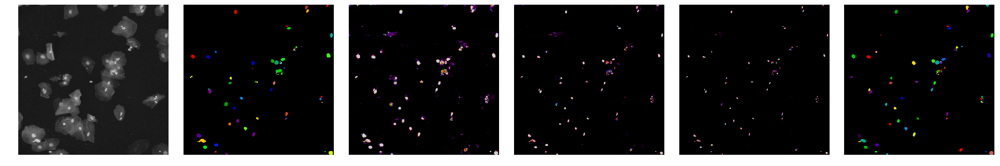

0.42545203344790294 0.606819890856


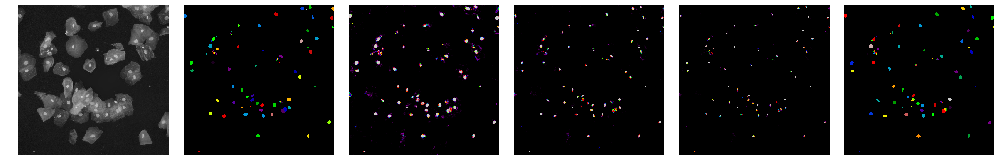

0.319750341671171 0.60187041587


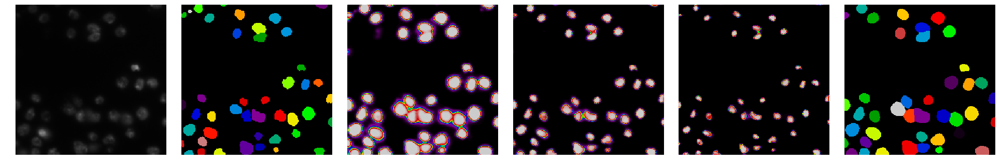

0.7923284580342645 0.605098518279


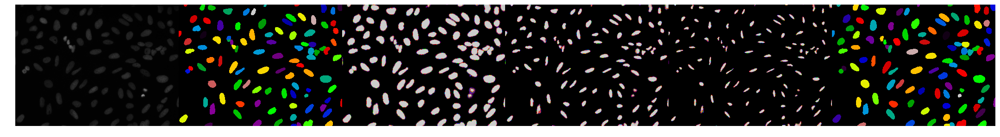

0.9127450980392158 0.610225961275


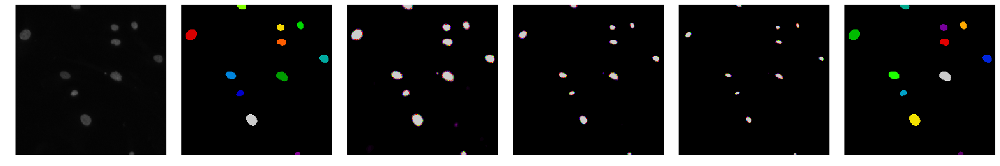

0.7925 0.613214060271


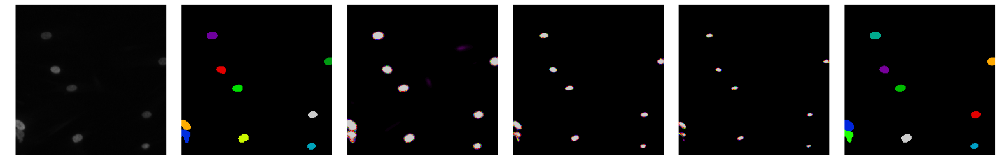

0.49100250834578285 0.611242906207


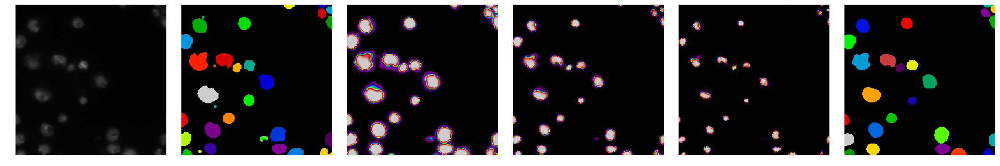

0.36548818461170657 0.607342037611


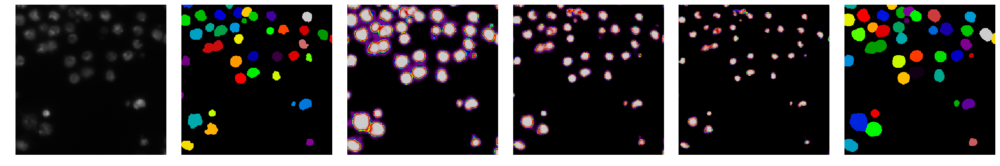

0.3517293568885185 0.603348089474


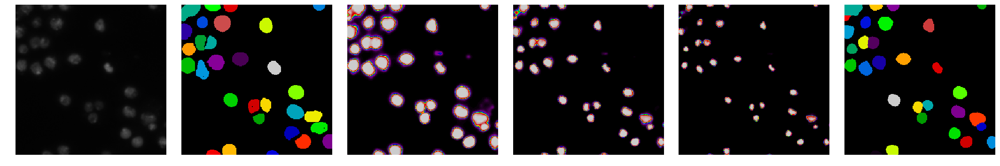

0.42480495826479847 0.600601272071


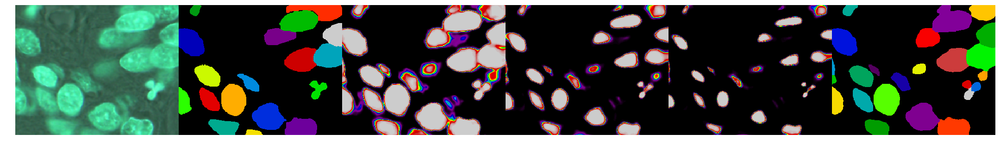

0.6248400484508478 0.600968526259


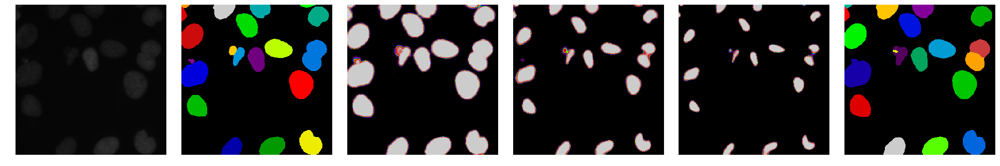

0.4023021573635807 0.598003356574


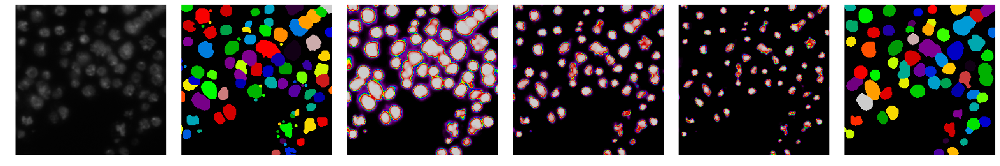

In [48]:
scores = []
for i, (img, pred) in enumerate(zip(val_images, val_predictions)):
    answer = watershed(pred,
        mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3)))
    scores.append(local_mean_iou(get_labels(val_labels[i]), get_labels(answer)))
    print(scores[-1], np.mean(scores))
    draw.plots([img, val_labels[i], pred[..., 0], pred[..., 1], pred[..., 2], answer * 12367 % 1000], col_number=6)
    plt.show()

0.3635181205553363 0.363518120555


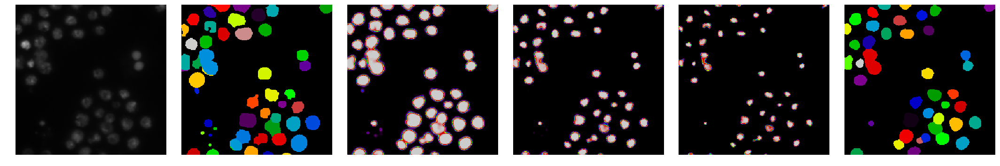

0.9111111111111111 0.637314615833


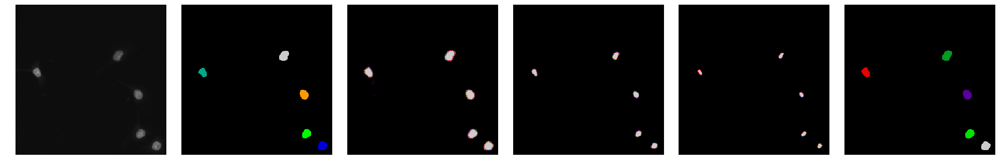

0.7888888888888889 0.687839373518


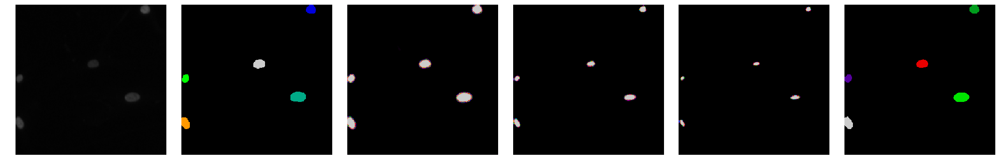

0.4623004433144781 0.631454640967


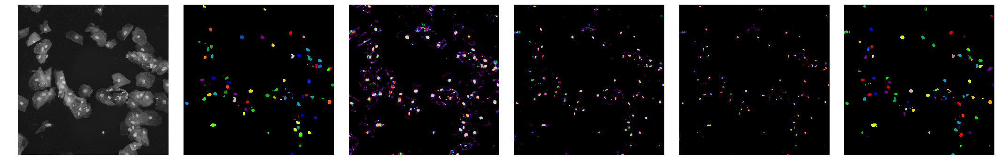

0.7694117647058822 0.659046065715


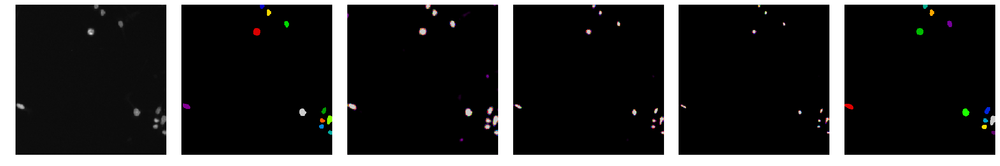

0.8982222222222221 0.698908758466


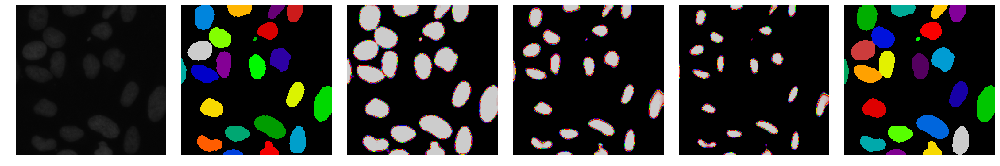

0.3991558147751566 0.656086909368


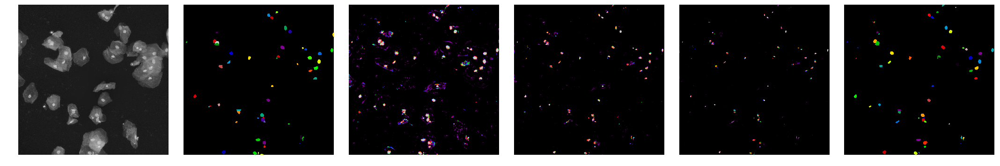

0.79 0.672826045697


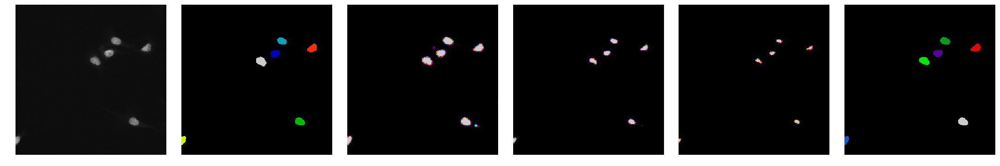

0.3759828444956722 0.639843467785


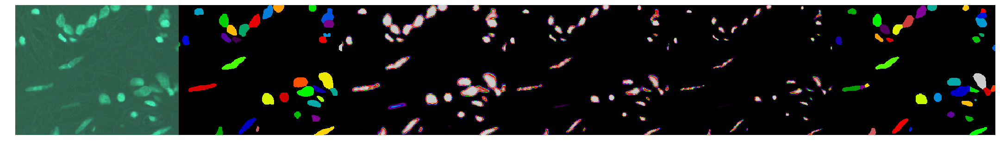

0.841321287408244 0.659991249748


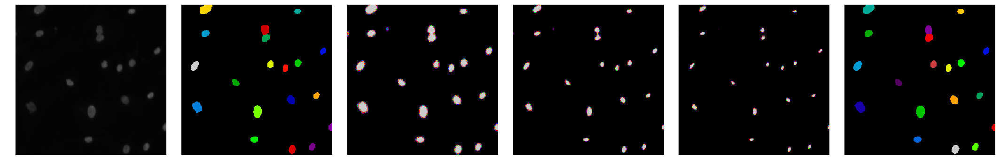

0.23095774680442874 0.620988204026


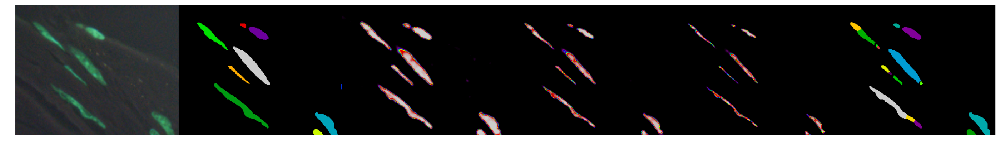

0.7778051709222998 0.6340562846


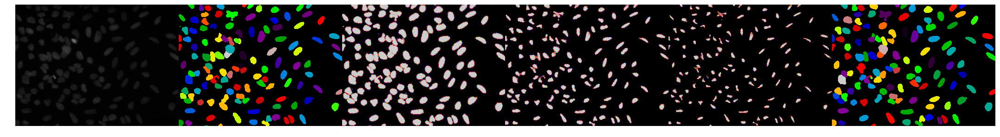

0.8909767441860466 0.653819396876


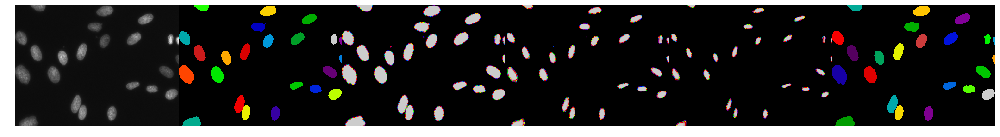

0.40758243963194396 0.636231042787


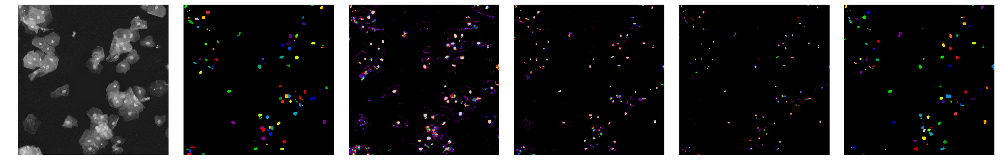

0.5453062824001164 0.630169392095


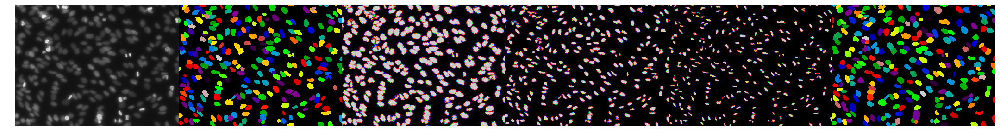

0.269684014864865 0.607639056018


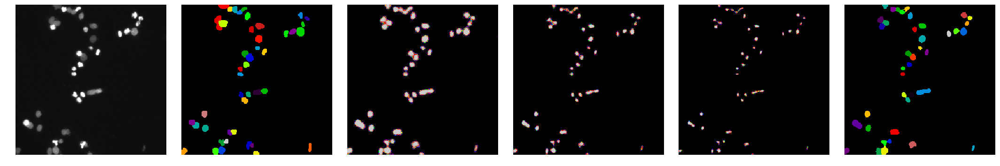

0.527762013729977 0.602940406472


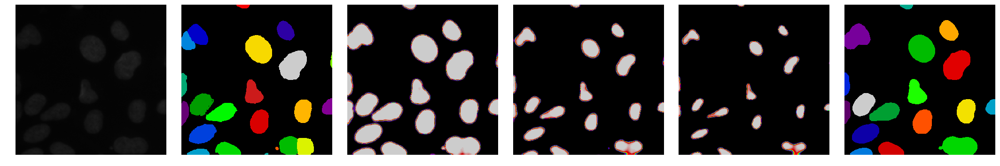

0.20169122864117303 0.580648785481


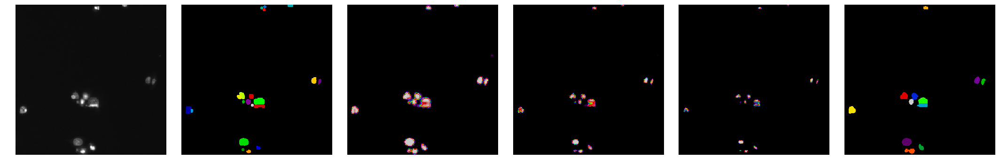

0.2824242424242424 0.564952756899


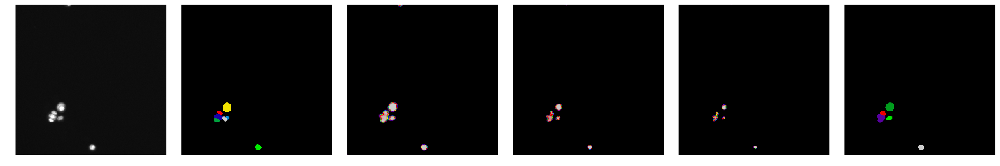

0.34974358974358977 0.554192298541


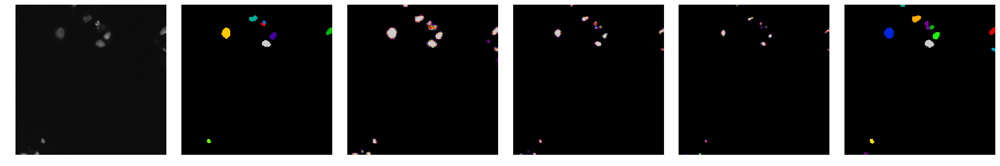

0.4565620868888692 0.549543240844


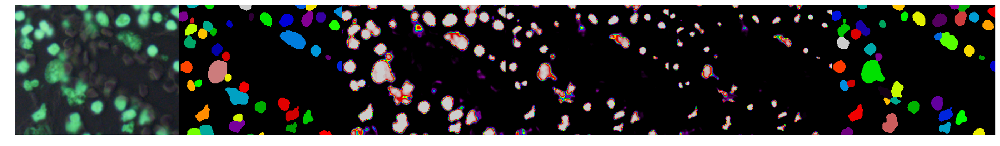

0.703030303030303 0.556519925488


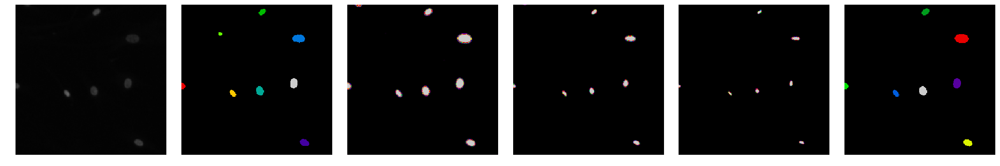

0.27255999897802086 0.544173841727


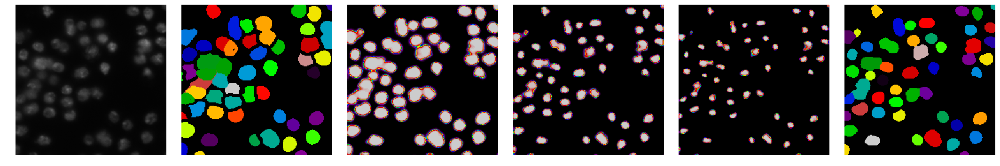

0.6571428571428573 0.548880884036


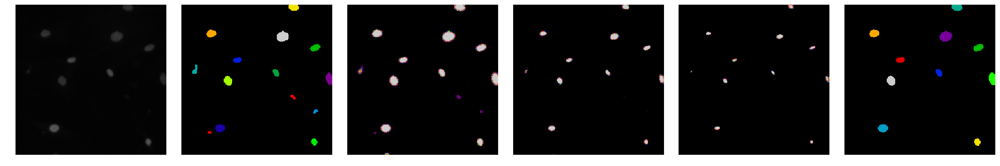

0.8732620320855615 0.561856129958


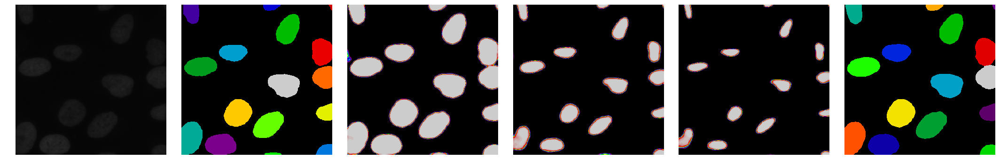

0.7108299805573262 0.567585893443


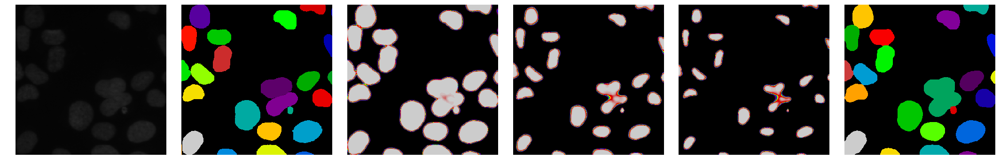

0.592266556856819 0.568499992088


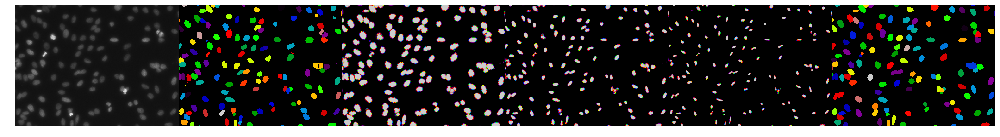

In [ ]:
scores = []
for i, (img, pred) in enumerate(zip(val_images, val_predictions)):
    answer = watershed(pred,
        mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3)))
    scores.append(local_mean_iou(get_labels(val_labels[i]), get_labels(answer)))
    print(scores[-1], np.mean(scores))
    draw.plots([img, val_labels[i], pred[..., 0], pred[..., 1], pred[..., 2], answer * 12367 % 1000], col_number=6)
    plt.show()

0.3420409907798919 0.34204099078


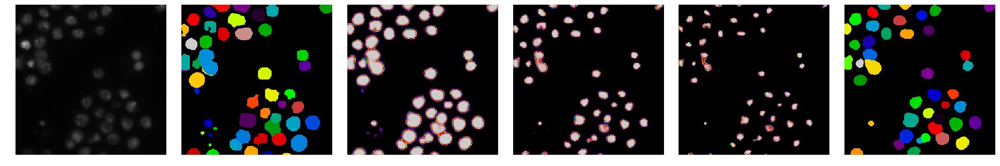

0.9111111111111111 0.626576050946


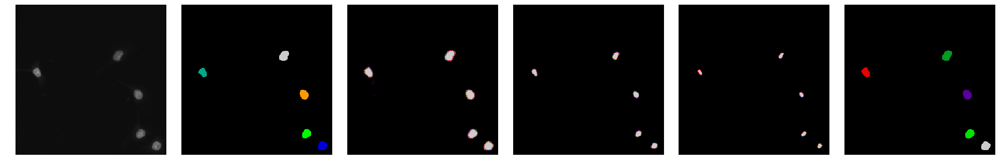

0.7888888888888889 0.68068033026


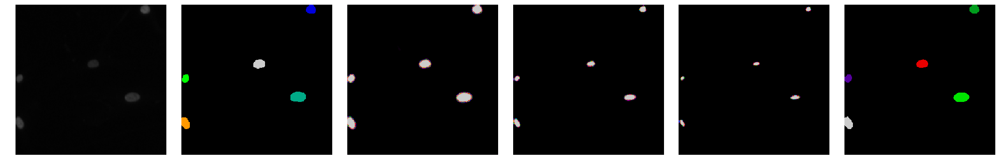

0.47790833593125487 0.629987331678


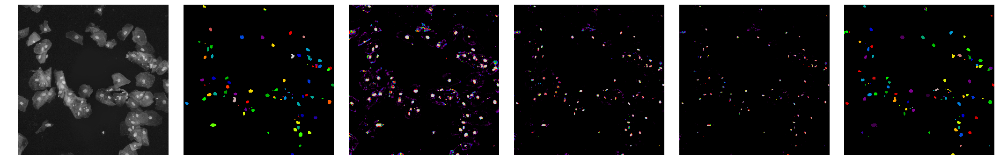

0.7694117647058822 0.657872218283


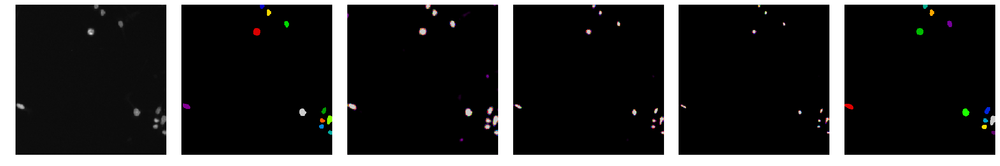

0.8045926361143753 0.682325621255


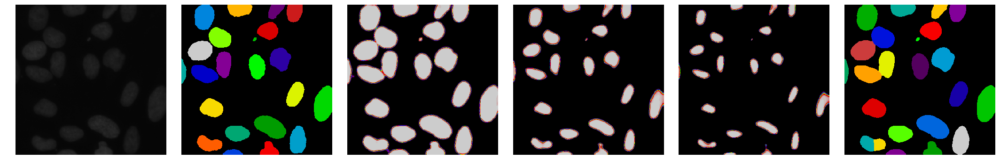

0.3991558147751566 0.641872791758


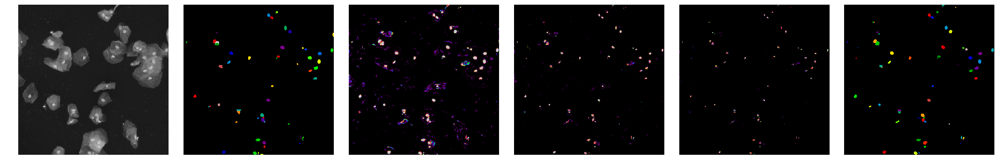

0.79 0.660388692788


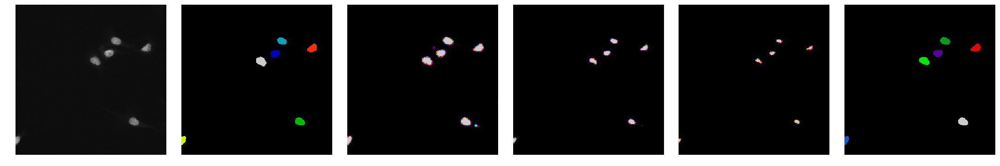

0.3409914441563813 0.624900109607


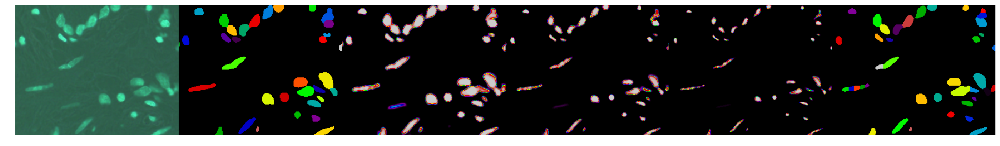

0.8379344781390816 0.64620354646


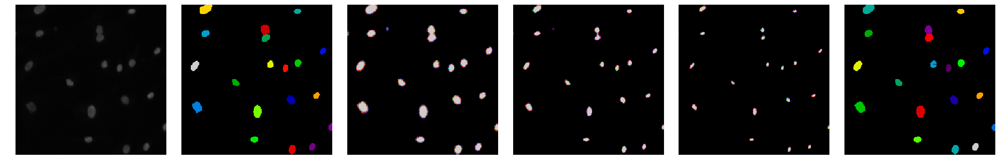

0.15990495012234143 0.601994583157


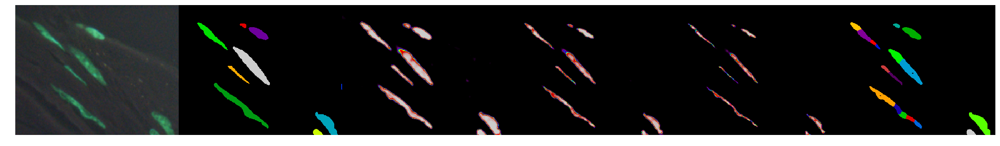

0.6819701875666799 0.608659216858


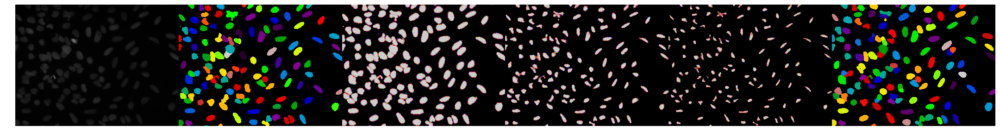

0.8909767441860466 0.630375949729


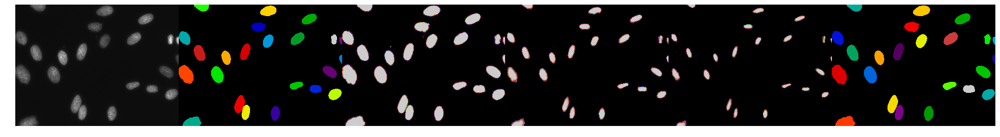

0.40758243963194396 0.614462127579


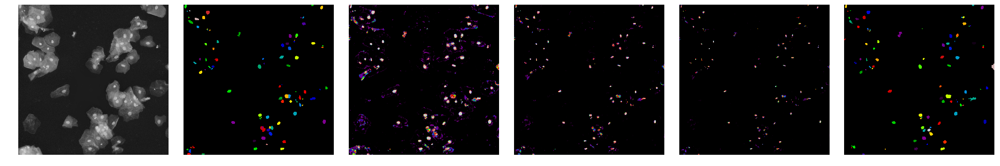

0.5613007157044454 0.610918033454


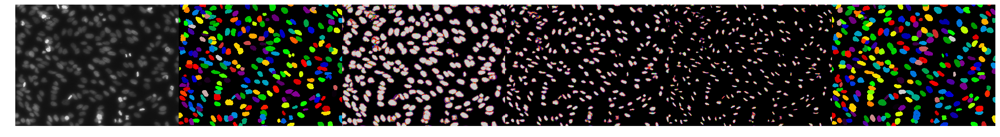

0.29627567803302013 0.59125288624


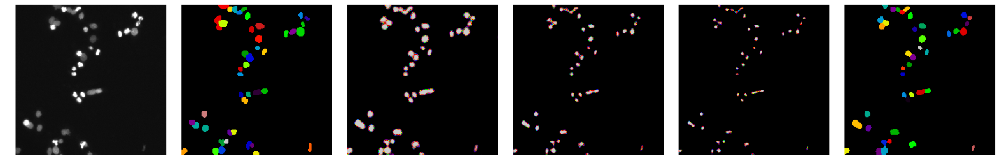

0.527762013729977 0.587518129034


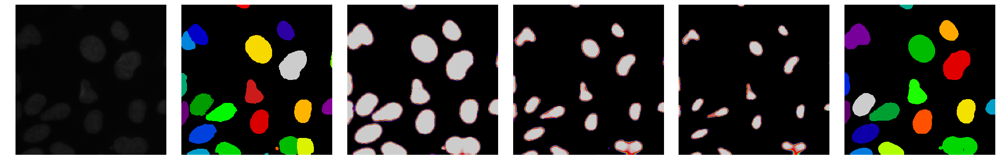

0.1864658674658675 0.565237447836


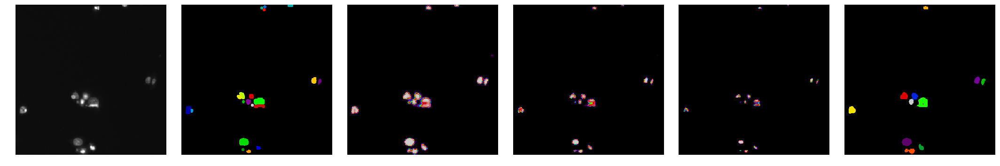

0.2824242424242424 0.550352542288


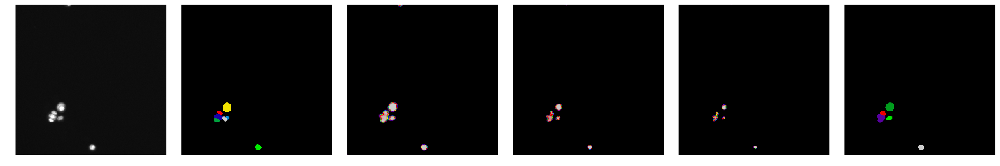

0.34974358974358977 0.540322094661


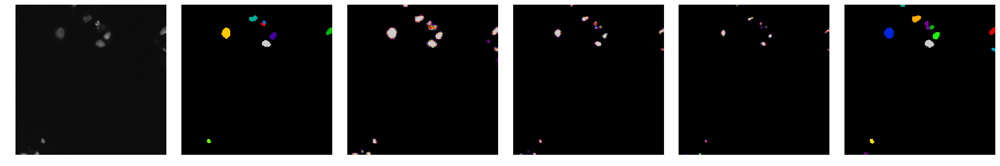

0.4775197303804754 0.537331505885


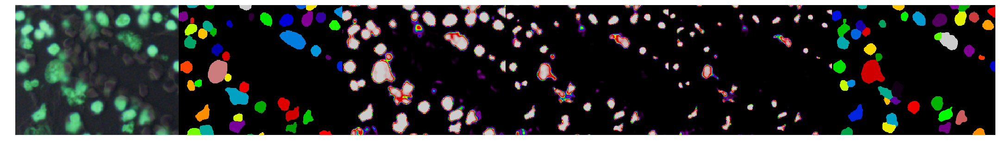

0.703030303030303 0.544863269392


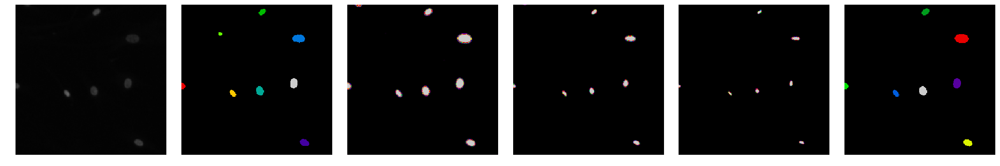

0.2905444790481462 0.533805930681


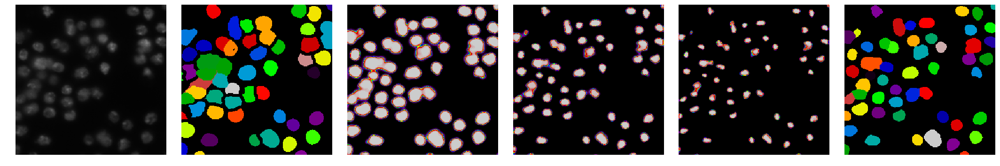

0.6571428571428573 0.538944969284


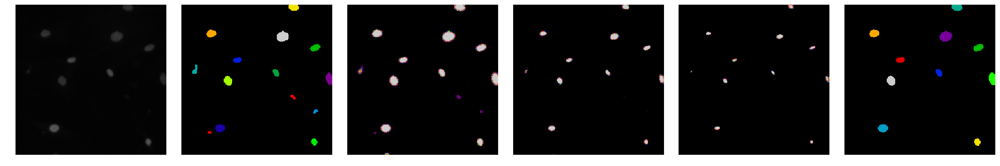

0.8732620320855615 0.552317651796


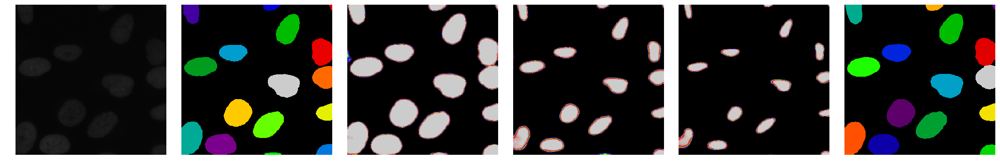

0.6204066934385049 0.55493646109


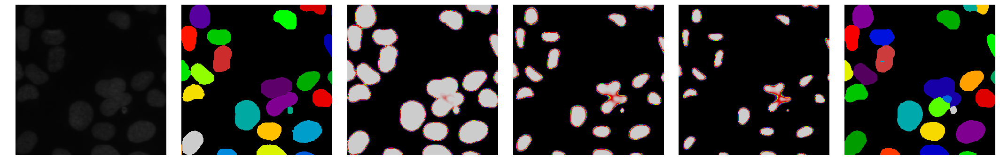

0.6407508187526373 0.558114770633


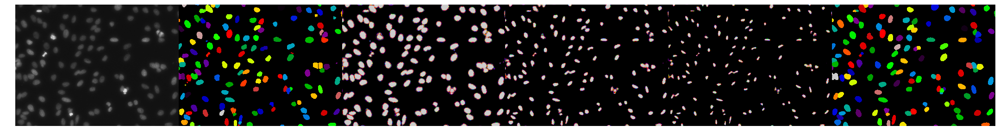

0.37405530050016816 0.551541218128


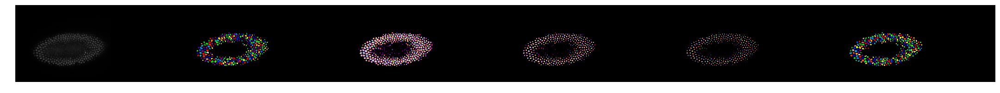

0.3121158724683669 0.543285171726


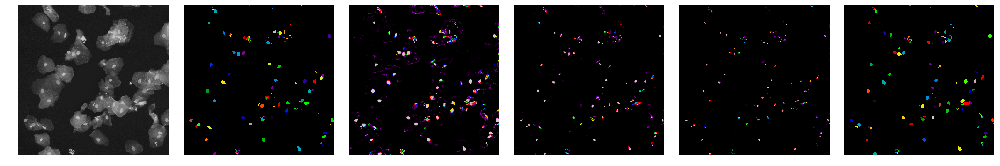

0.7584615384615384 0.550457717284


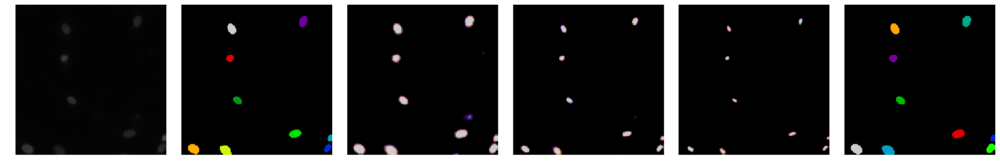

0.7137042369395311 0.555723734047


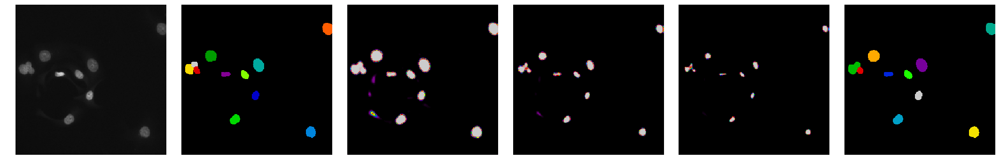

0.22414849455805053 0.545362007813


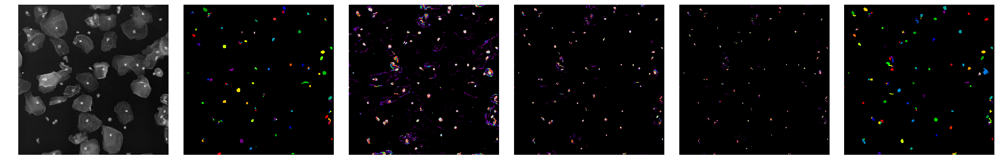

0.9142857142857143 0.55654151407


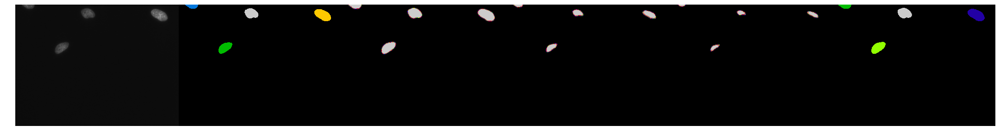

0.47752442223623304 0.554217481957


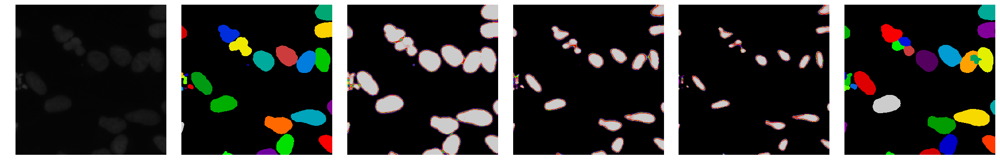

0.42954953079016045 0.550655540495


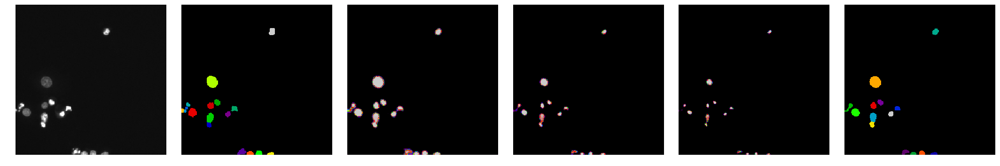

0.737234515274891 0.555838289795


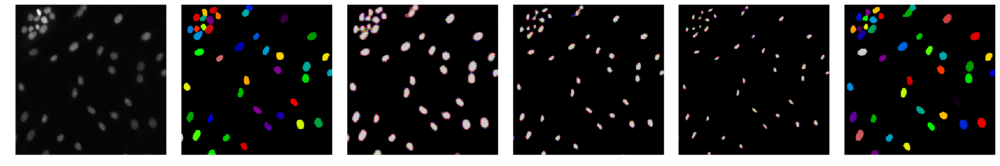

0.6832492000752869 0.55928182791


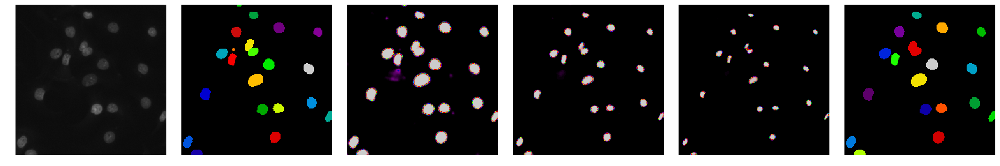

0.8485429769392032 0.566893963411


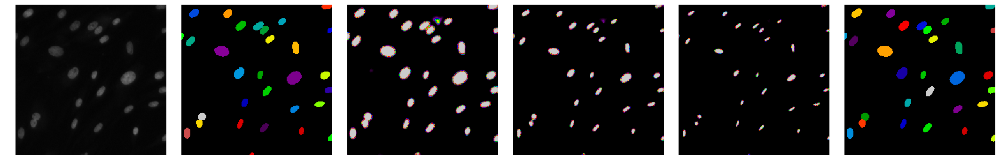

0.7981785714285714 0.572824337976


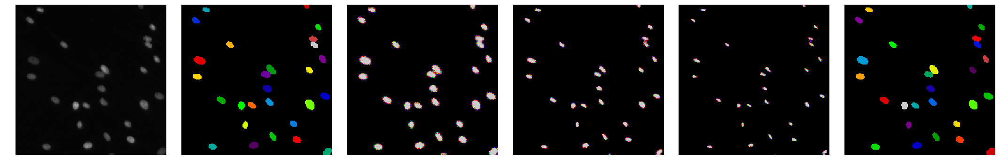

0.4025358551712853 0.568567125905


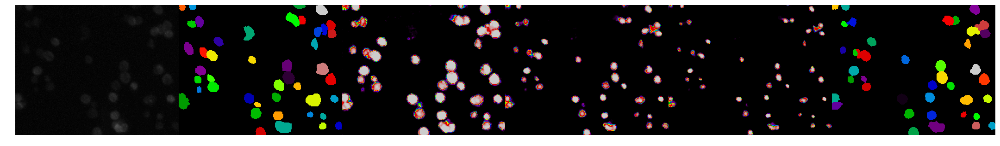

0.6145170345896696 0.569687855386


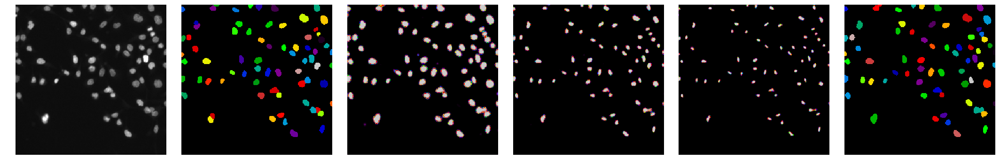

0.653932178932179 0.571693672613


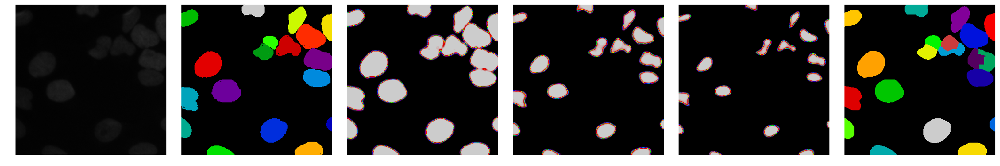

0.6314322170286163 0.573082941088


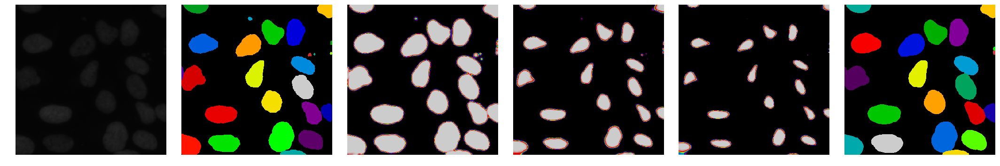

0.8404761904761905 0.579160060392


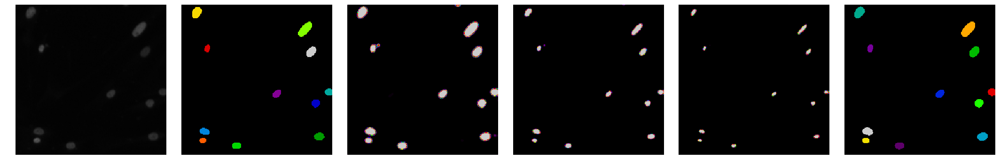

0.7476315789473682 0.582903871915


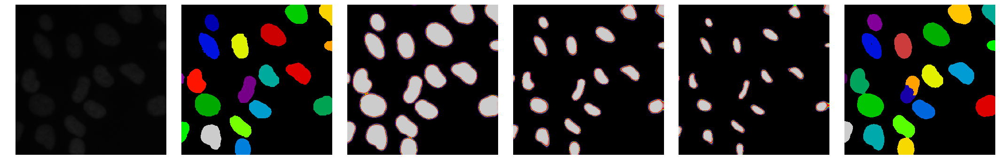

0.640909090909091 0.584164854937


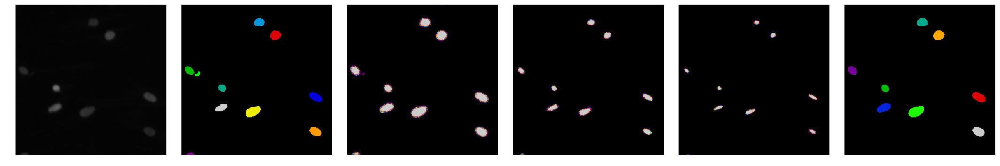

0.9192307692307692 0.591293916943


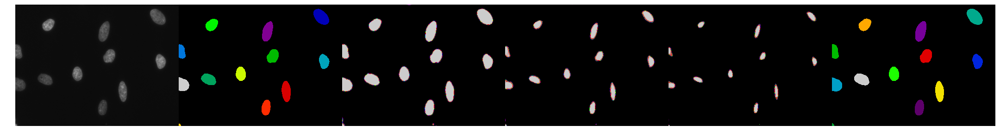

0.4337261844560256 0.58801125585


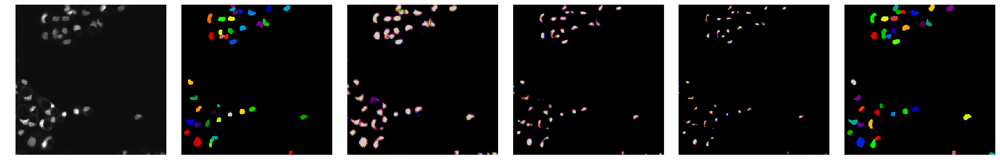

0.33008602153832534 0.582747475558


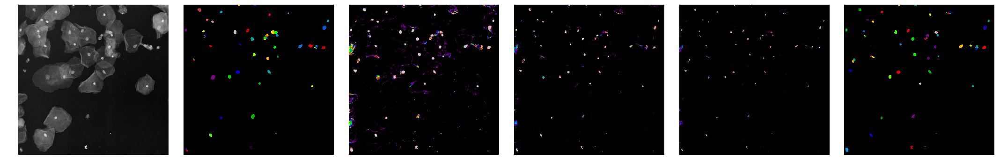

0.6324621212121212 0.583741768471


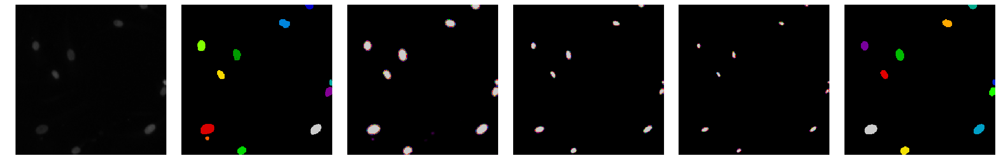

0.7946428571428571 0.587877083935


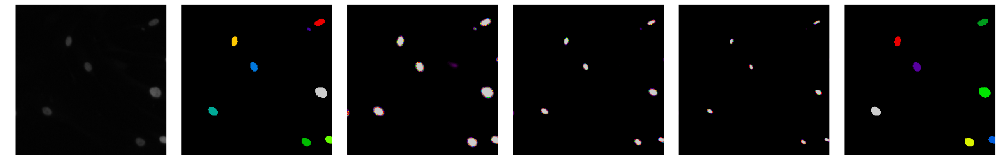

0.8793650793650792 0.593482622309


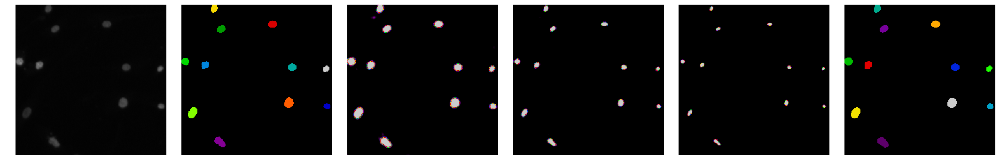

0.2378902655218445 0.586773332558


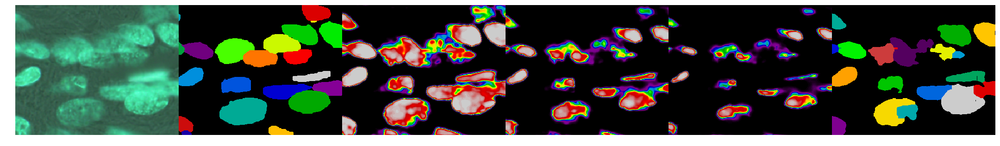

0.44094954268354736 0.584072892005


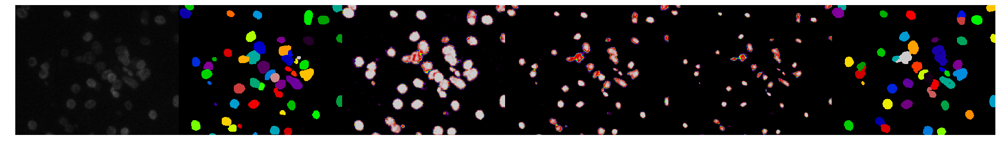

0.3303683818504883 0.579460082729


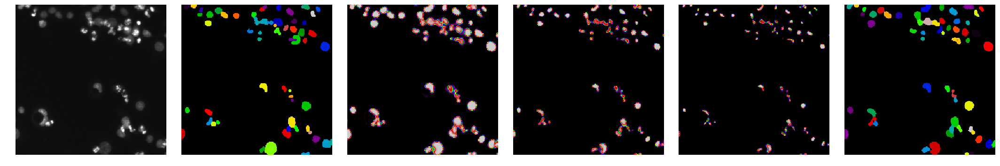

0.313358587697843 0.574708270318


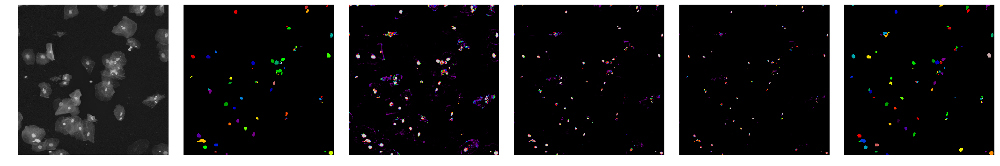

0.3952081799745403 0.571559145926


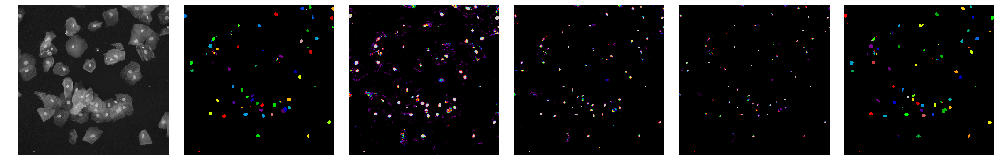

0.41122461153707607 0.568794757402


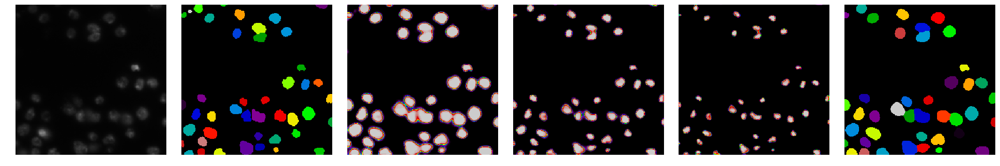

0.6970840147851642 0.570969151595


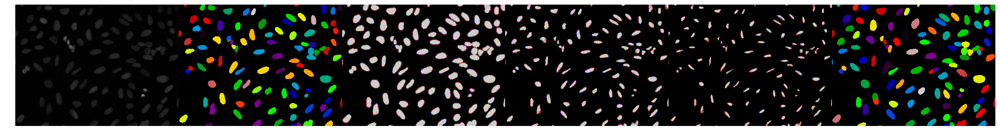

0.93 0.576952999068


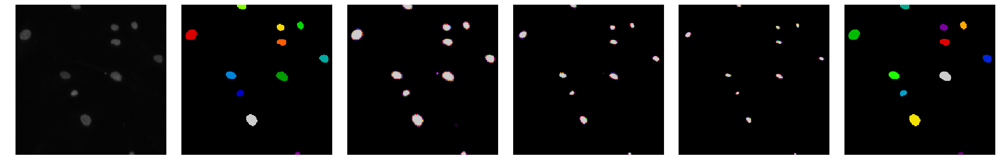

0.8058823529411765 0.580705939296


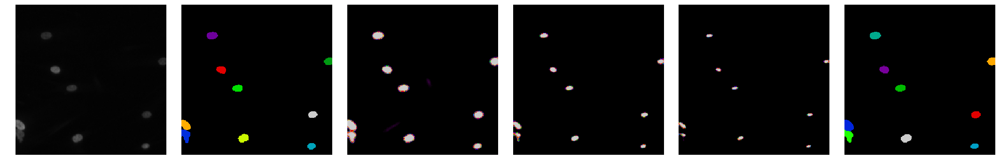

0.4438708174842823 0.578498921202


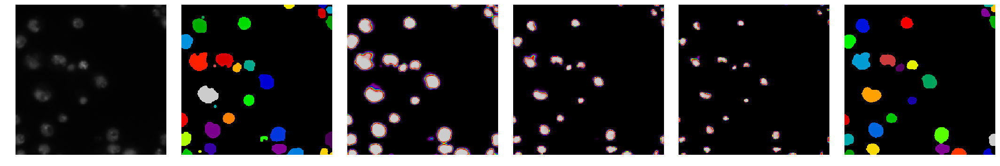

0.3963667767787938 0.575607934783


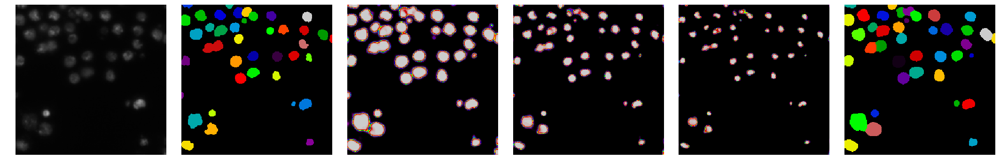

0.313167151184978 0.571507297539


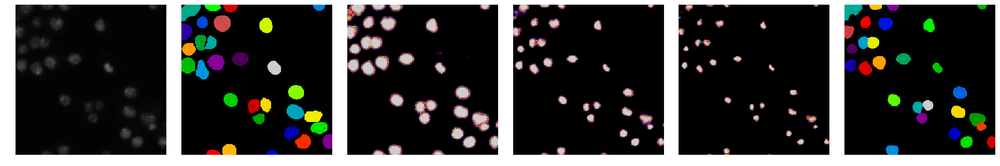

0.3073997493206337 0.567444104489


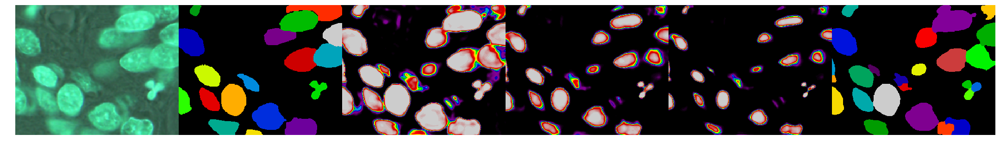

0.6621127815421293 0.568878478384


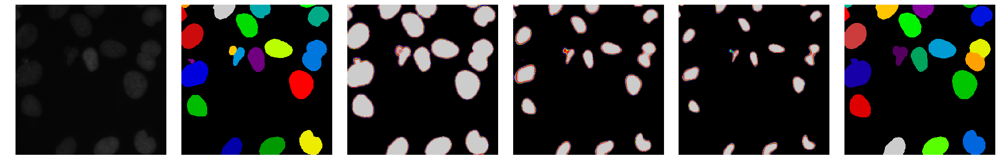

0.4253282600215974 0.566735937811


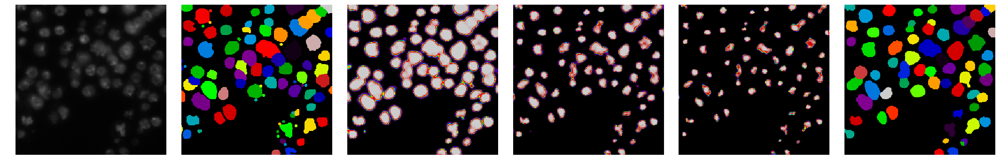

In [20]:
scores = []
for i, (img, pred) in enumerate(zip(val_images, val_predictions)):
    answer = watershed(pred,
        mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3)))
    scores.append(local_mean_iou(get_labels(val_labels[i]), get_labels(answer)))
    print(scores[-1], np.mean(scores))
    draw.plots([img, val_labels[i], pred[..., 0], pred[..., 1], pred[..., 2], answer * 12367 % 1000], col_number=6)
    plt.show()

0.370124109160637 0.370124109161


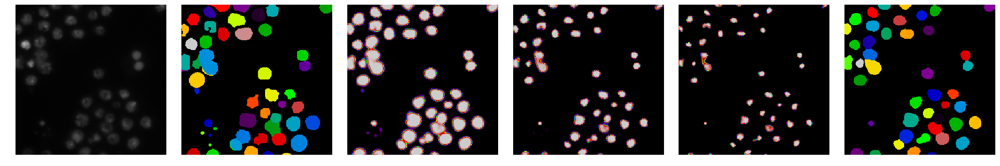

0.9111111111111111 0.640617610136


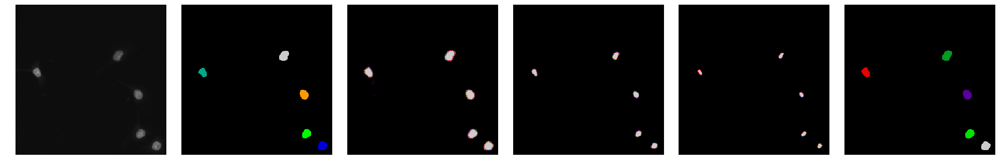

0.7888888888888889 0.69004136972


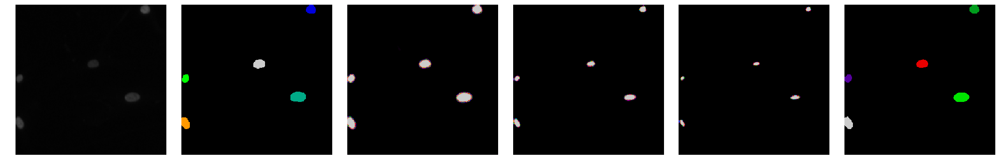

0.45688304101895244 0.631751787545


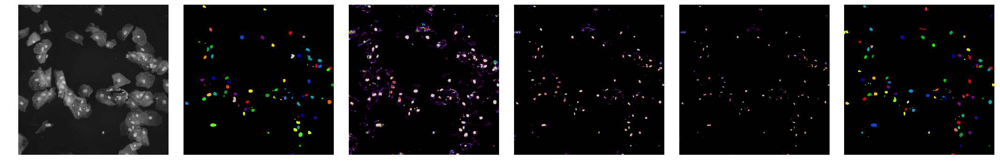

0.7694117647058822 0.659283782977


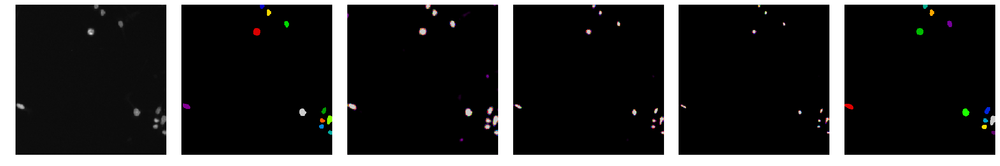

0.6713847794976828 0.661300615731


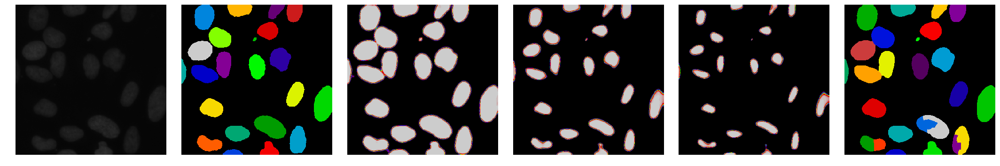

0.38973636376021437 0.622505722592


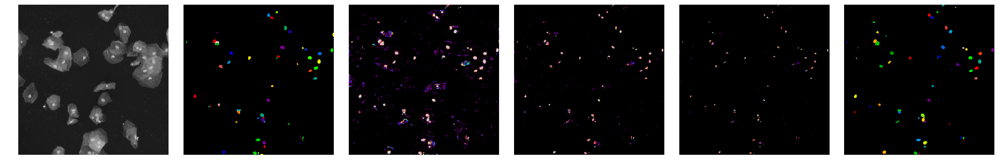

0.79 0.643442507268


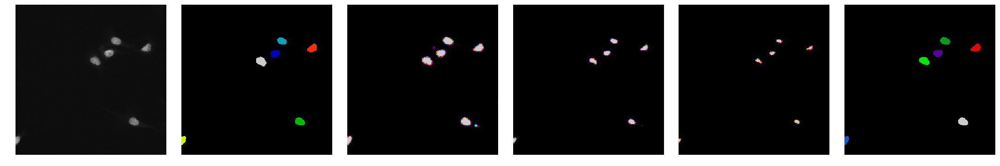

0.38429748460826446 0.614648615861


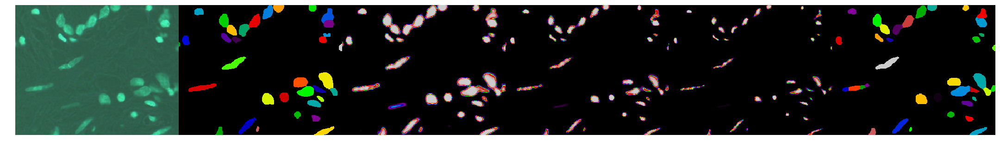

0.841321287408244 0.637315883016


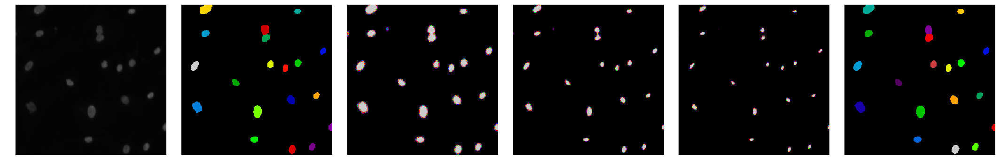

0.17791360813099943 0.595552039845


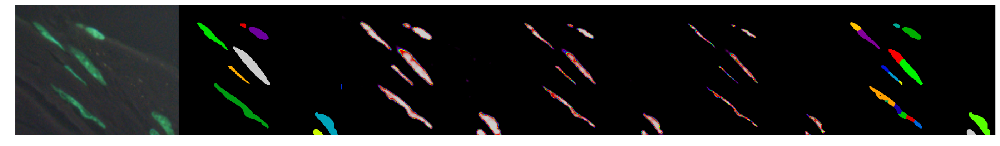

0.7242612638182493 0.606277808509


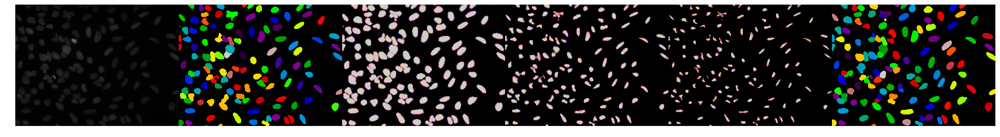

0.8909767441860466 0.628177726638


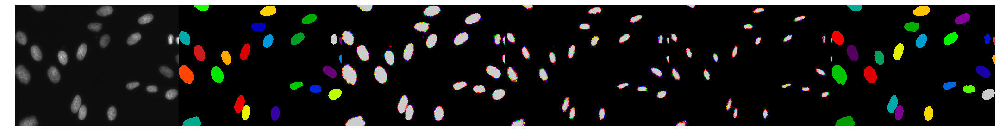

0.4020582267414169 0.612026333788


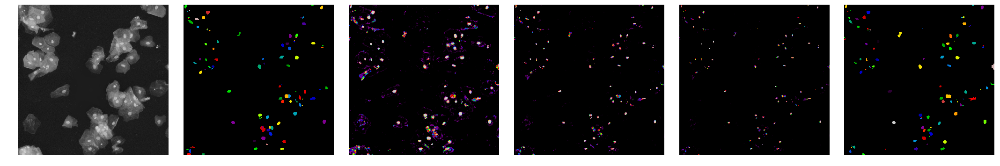

0.5662703874361343 0.608975937365


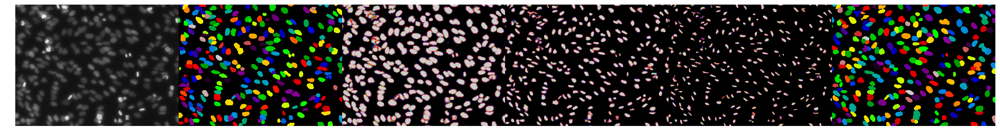

0.27128218838084667 0.587870078053


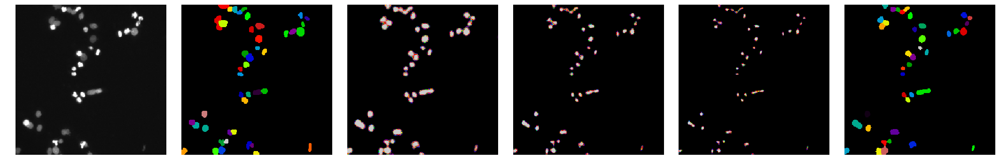

0.5213842415635894 0.583959146495


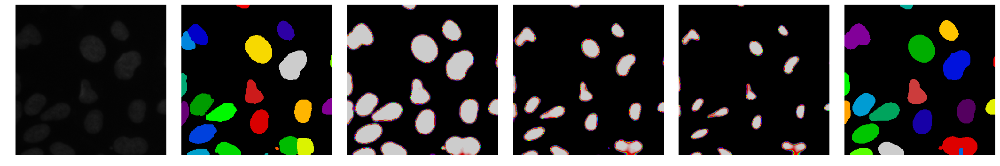

0.17895922956134785 0.56145915111


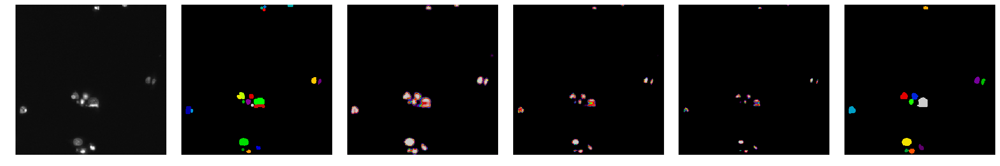

0.18777777777777782 0.541791710408


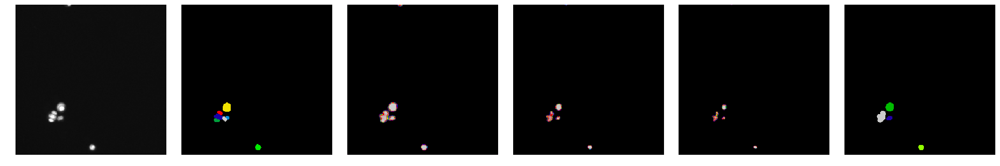

0.33598901098901096 0.531501575437


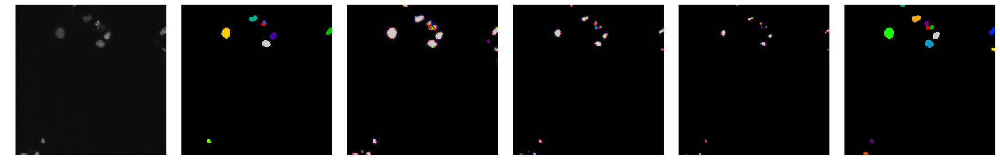

0.4585825213304859 0.528029239527


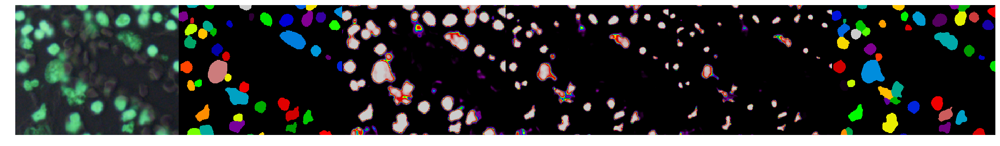

0.703030303030303 0.535983833323


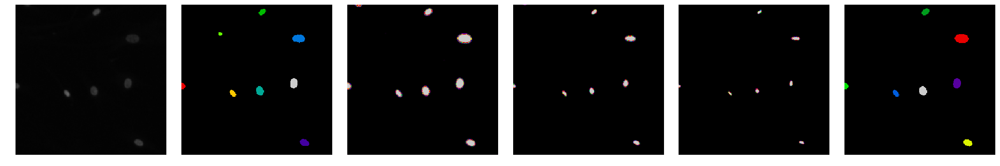

0.29626041079780097 0.525561075822


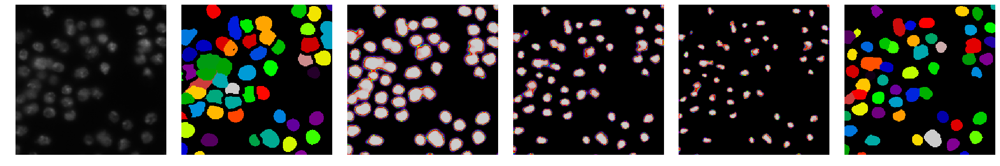

0.6136363636363636 0.529230879481


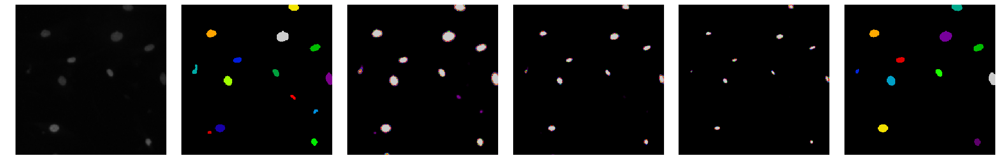

0.9169082125603867 0.544737972804


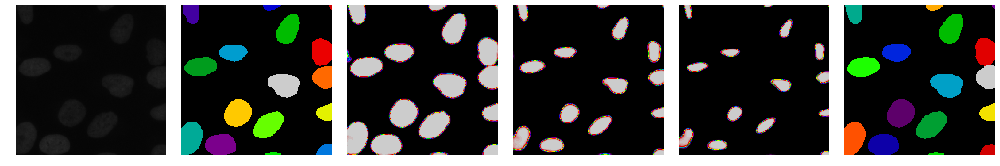

0.6204066934385049 0.547648308213


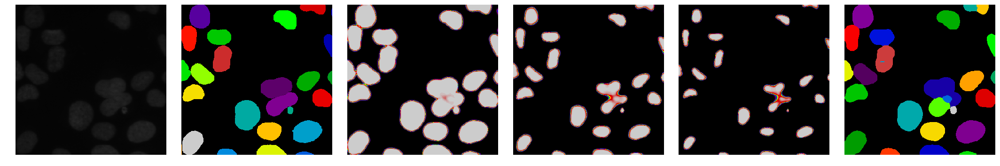

0.6531282313777227 0.551554972034


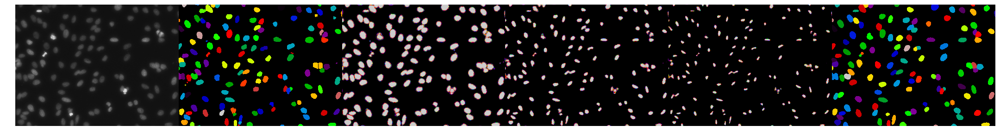

0.3716791591555101 0.54513083586


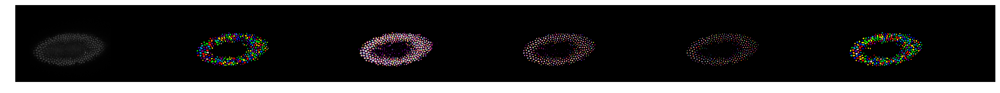

0.30957093113417544 0.537008080524


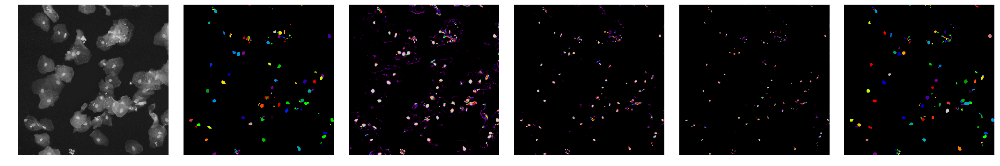

0.7584615384615384 0.544389862456


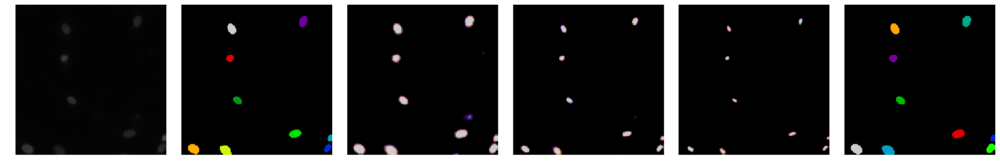

0.6011904761904762 0.546222140318


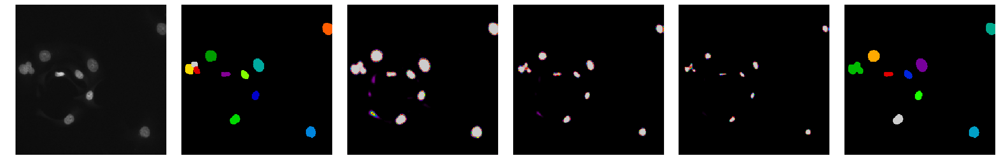

0.20784262696034395 0.535647780526


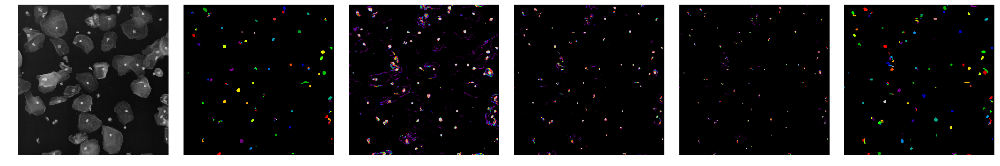

0.9142857142857143 0.547121657306


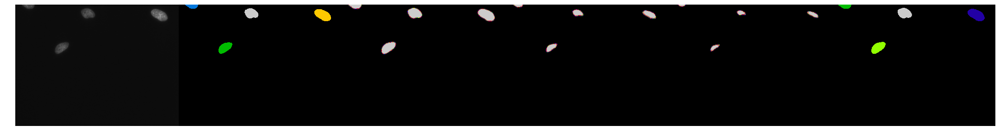

0.4989979293152668 0.545706253542


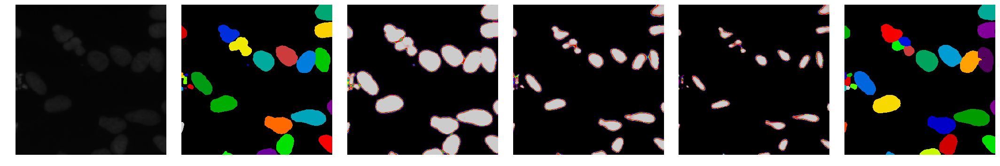

0.42954953079016045 0.542387490035


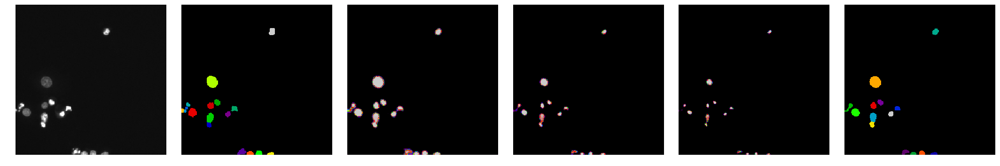

0.7478437322513671 0.548094607874


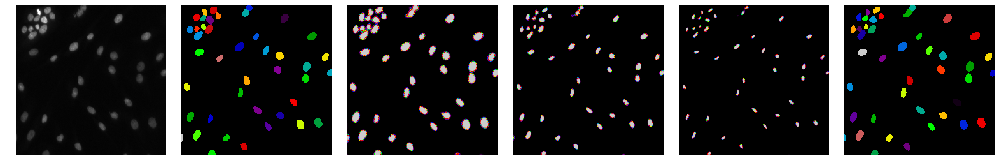

0.680321272147359 0.551668301503


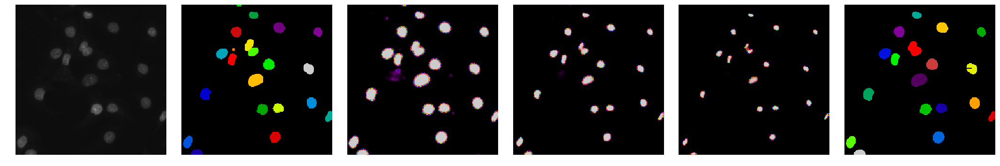

0.8485429769392032 0.559480792962


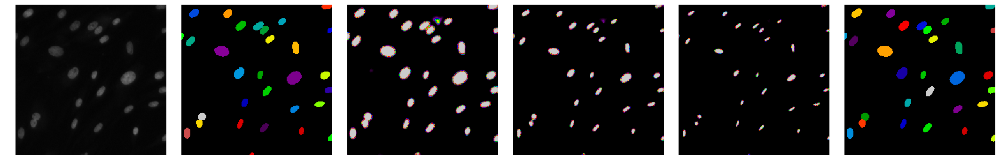

0.7981785714285714 0.56560124882


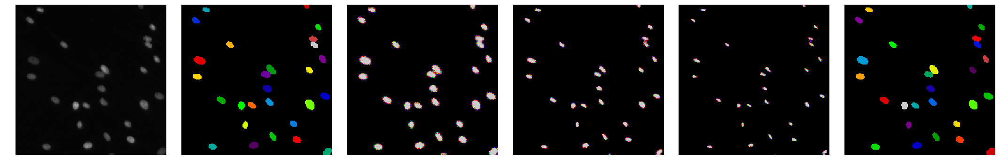

0.39510834607566525 0.561338926251


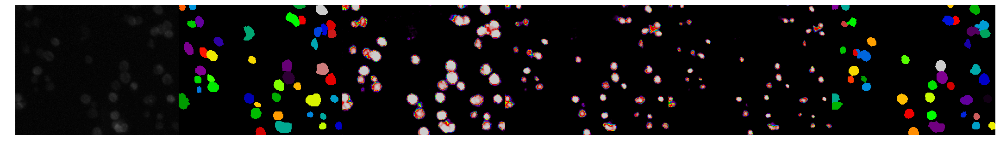

0.6145170345896696 0.562635953284


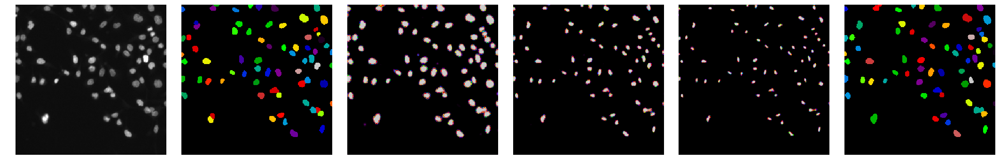

0.653932178932179 0.564809672942


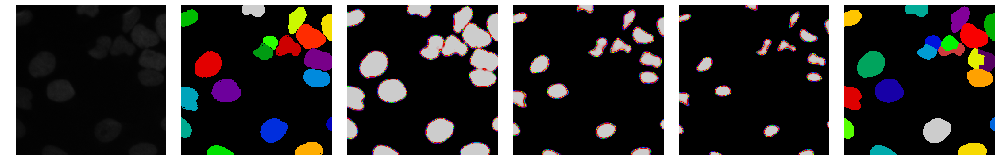

0.5898165068771299 0.56539122722


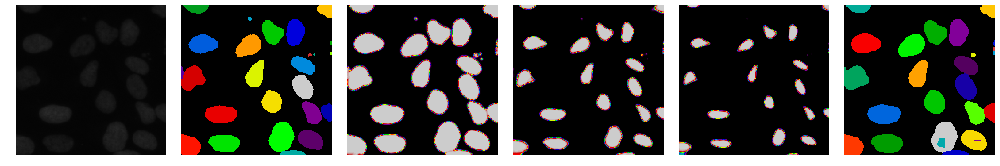

0.8404761904761905 0.571643158203


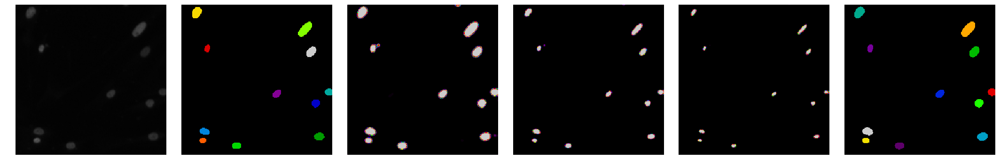

0.6420165985383376 0.573207012433


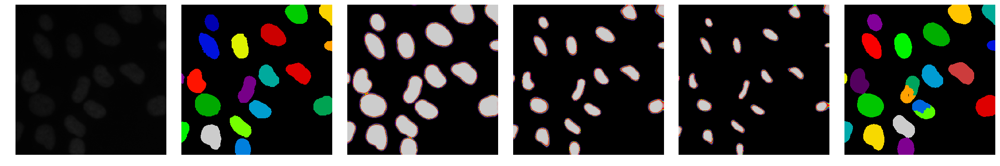

0.699941724941725 0.575962114878


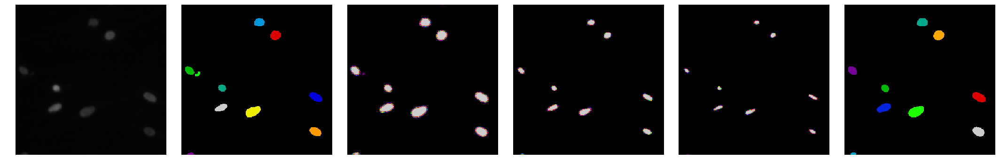

0.7726754385964911 0.580147504745


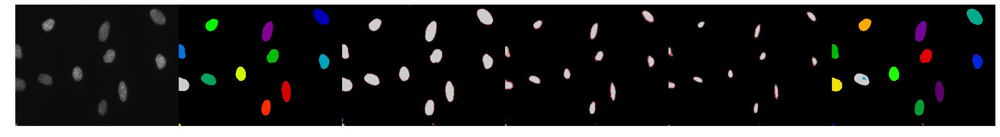

0.436044480195374 0.5771453584


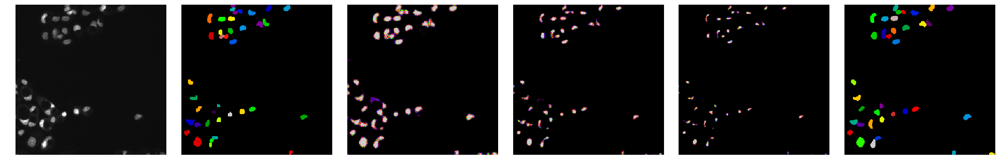

0.3027496733706487 0.571545446461


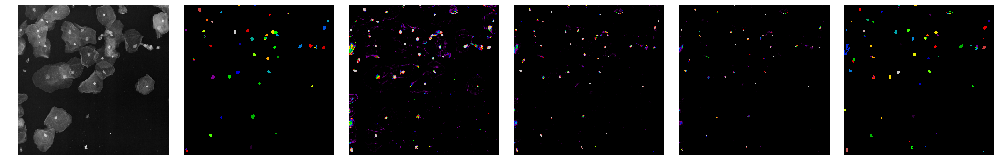

0.6324621212121212 0.572763779956


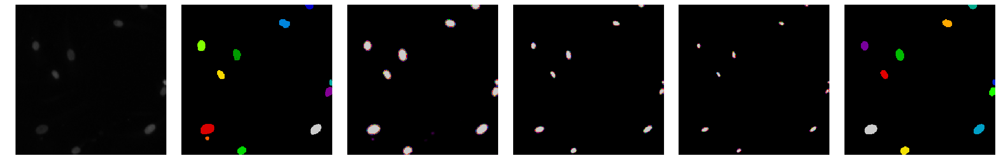

0.7946428571428571 0.577114350097


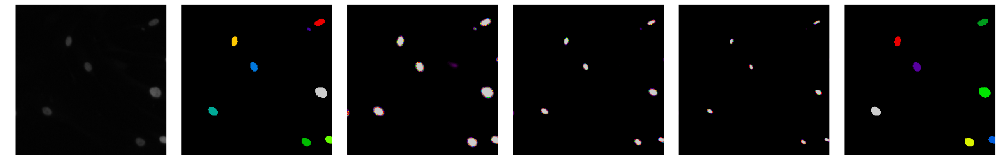

0.8793650793650792 0.582926864121


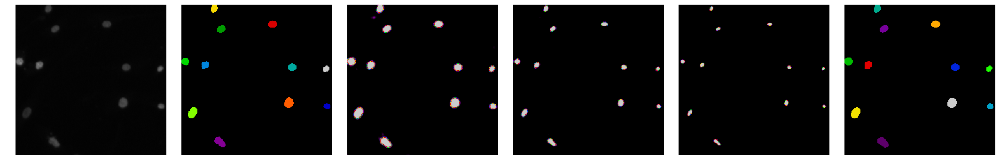

0.2276450354313507 0.576223433391


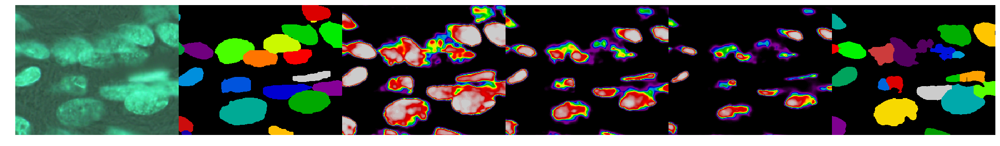

0.43483153298890215 0.573605064865


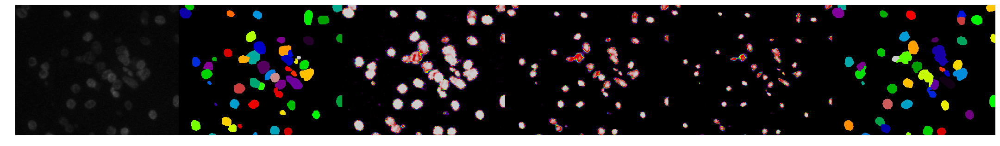

0.3391694545071457 0.569342599222


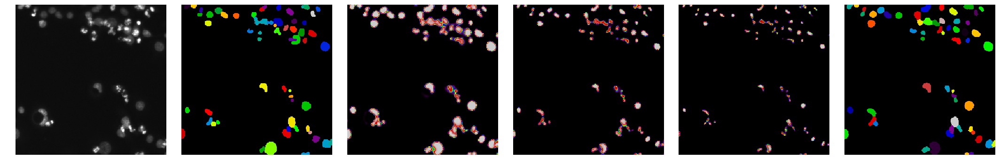

0.2834501423529419 0.564237376778


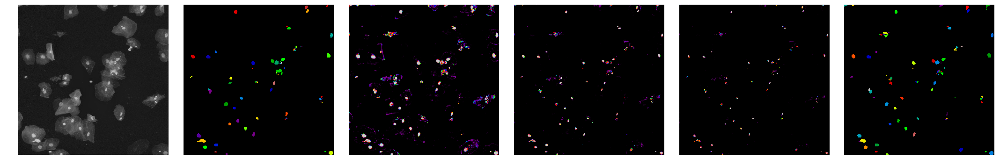

0.377798779711854 0.560966524198


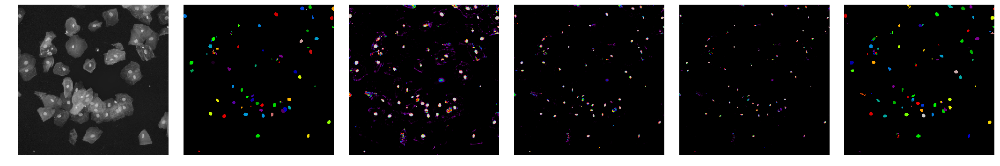

0.4254743128492769 0.558630451588


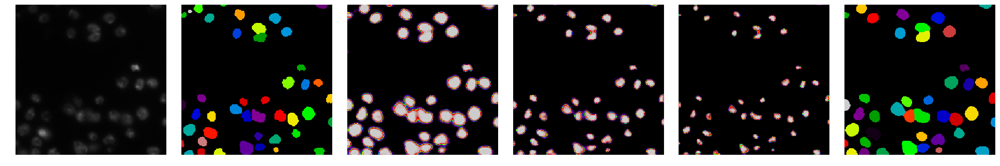

0.6970840147851642 0.560977122151


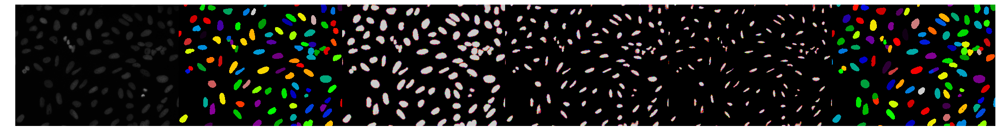

0.93 0.567127503449


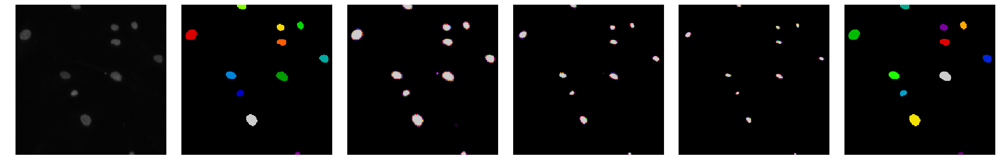

0.8058823529411765 0.571041517375


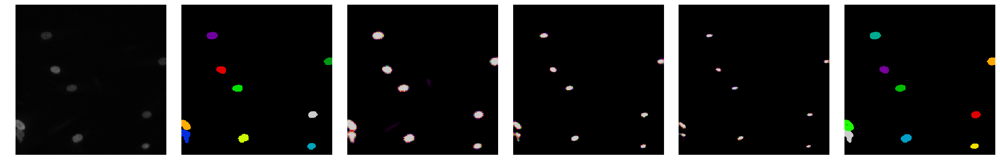

0.44202650818722244 0.56896063013


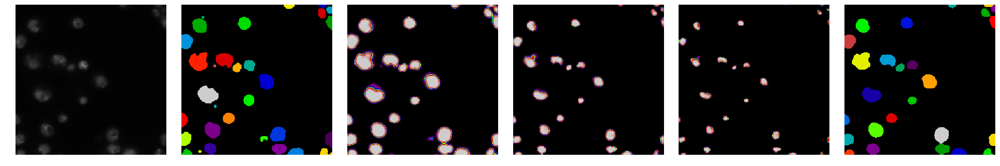

0.39998960311050114 0.566278550336


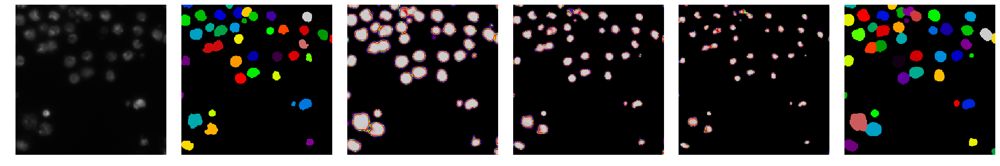

0.31872645732501786 0.562410548883


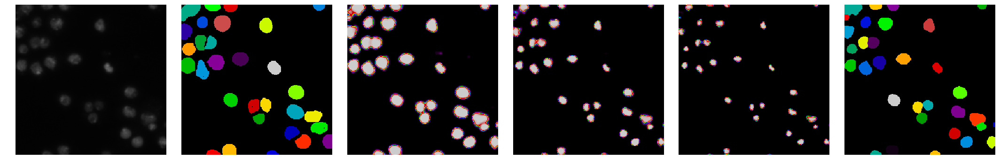

0.37108614550653013 0.559467096523


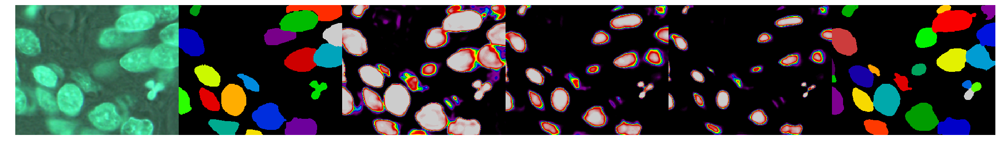

0.6621127815421293 0.561022334175


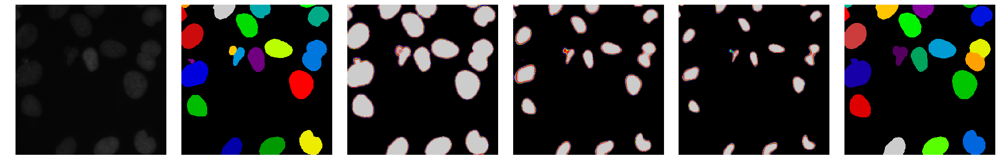

0.4213608141478785 0.558937833876


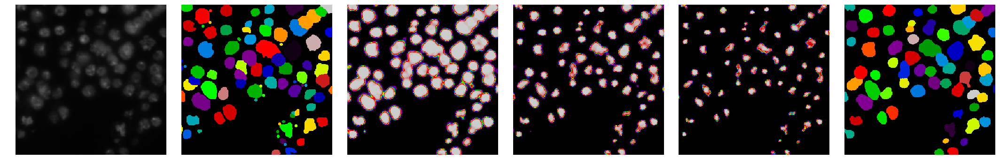

In [15]:
scores = []
for i, (img, pred) in enumerate(zip(val_images, val_predictions)):
    answer = watershed(pred,
        mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3)))
    scores.append(local_mean_iou(get_labels(val_labels[i]), get_labels(answer)))
    print(scores[-1], np.mean(scores))
    draw.plots([img, val_labels[i], pred[..., 0], pred[..., 1], pred[..., 2], answer * 12367 % 1000], col_number=6)
    plt.show()

In [49]:
np.mean(scores)

0.59800335657375769

In [50]:
test_transform = transforms.DualCompose(
    [
        transforms.ImageOnly(transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]))
    ]
)

test_predictions, test_names = predict.predict(model, test_ids, "../../data/test/{}.png", test_transform, 1, 2)

Predict: 100%|██████████| 65/65 [00:04<00:00, 15.98it/s]


In [51]:
test_images = []
for _id in tqdm(test_names):
    test_images.append(cv2.imread("../../data/test/{}.png".format(_id)))

100%|██████████| 65/65 [00:00<00:00, 332.24it/s]


0


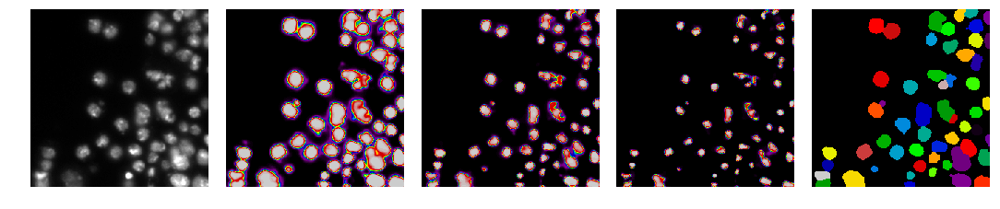

1


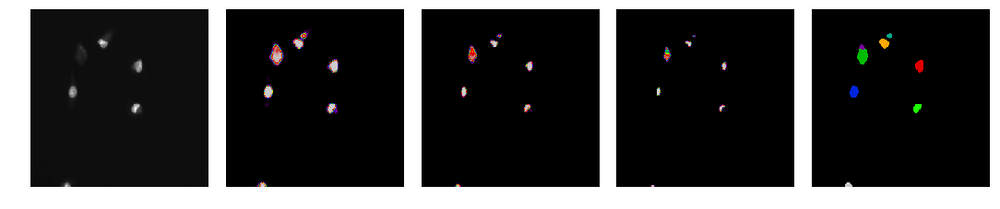

2


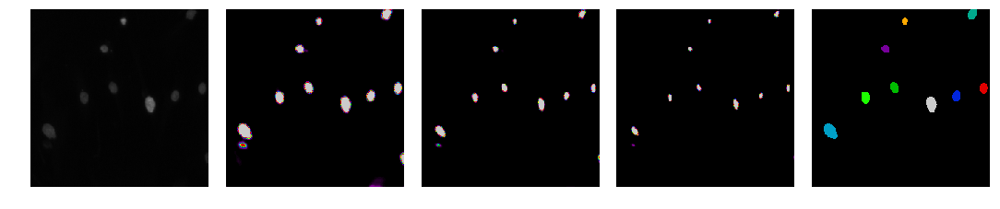

3


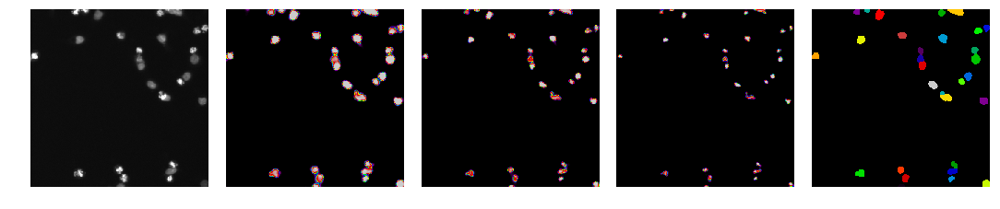

4


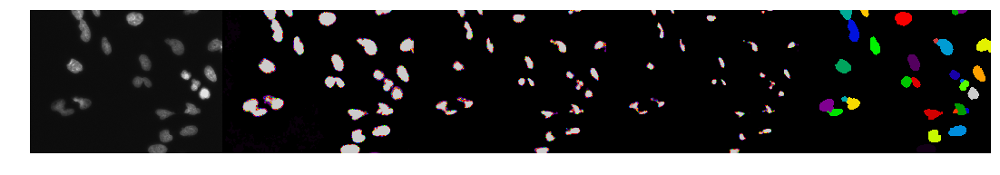

5


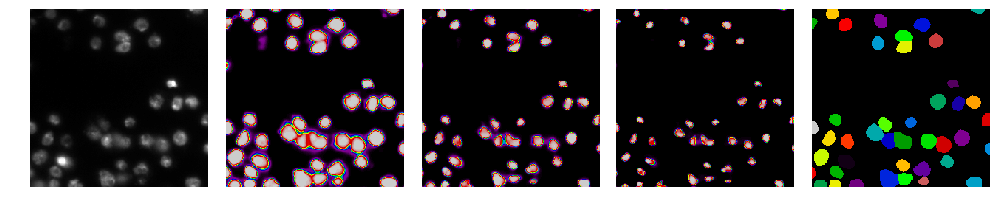

6


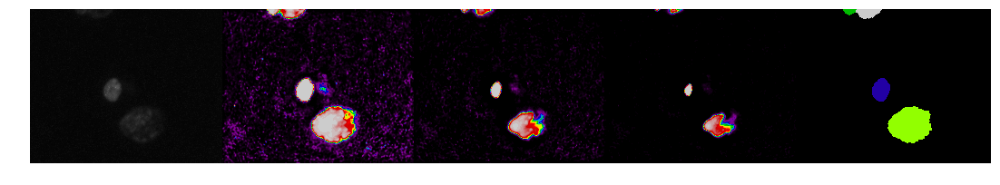

7


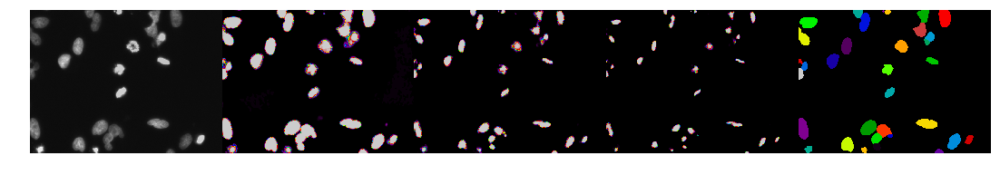

8


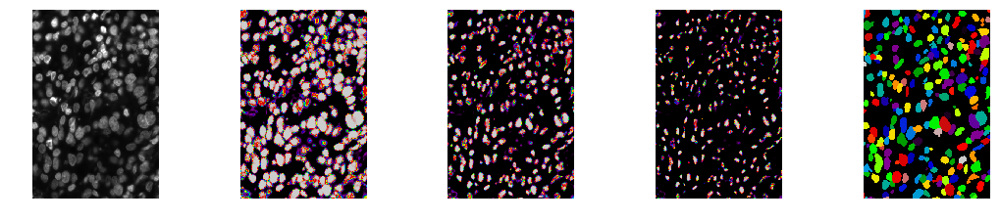

9


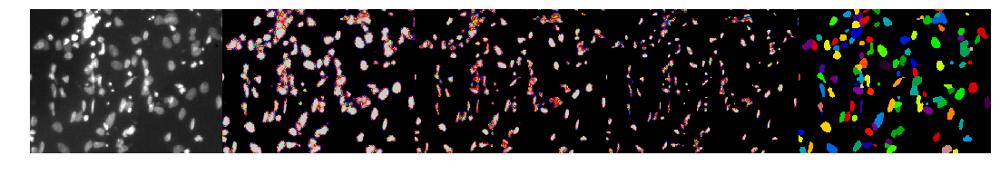

10


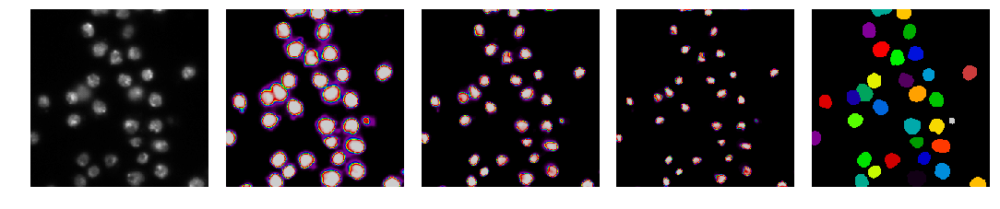

11


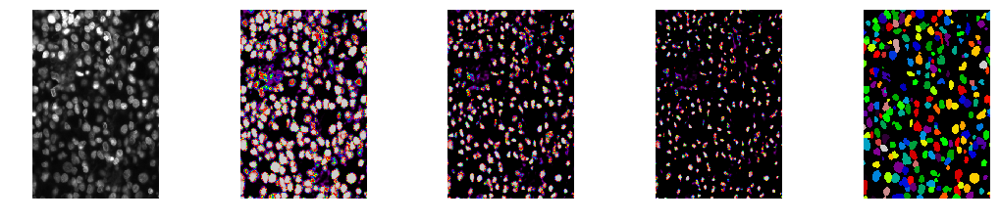

12


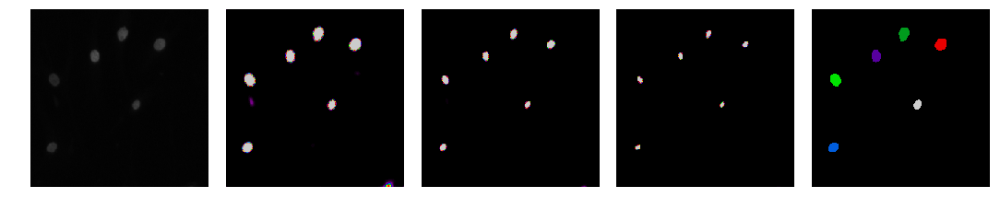

13


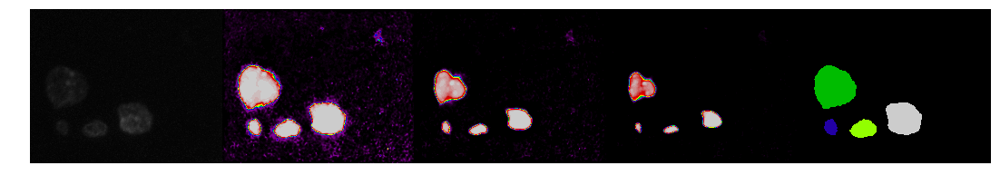

14


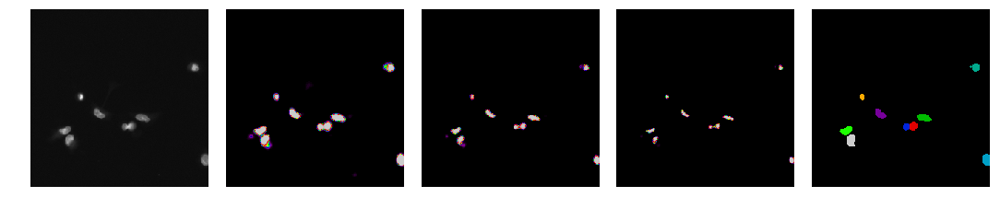

15


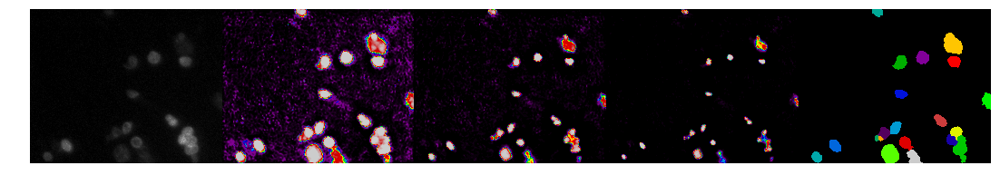

16


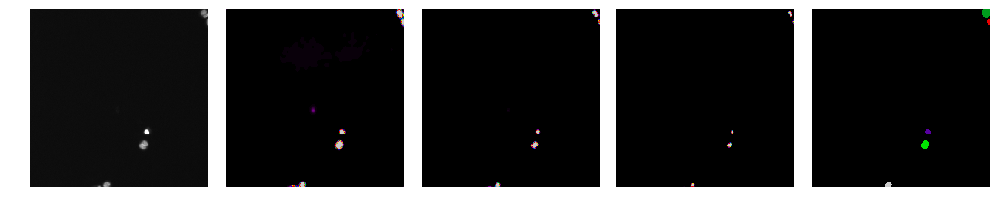

17


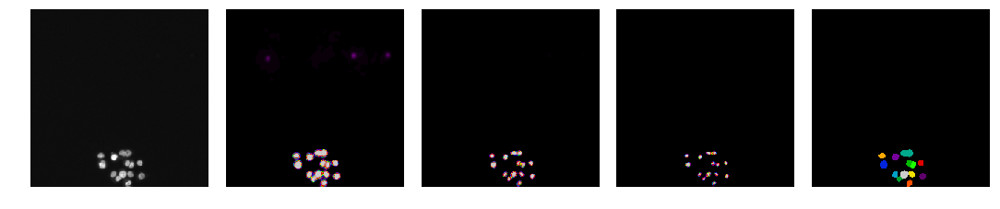

18


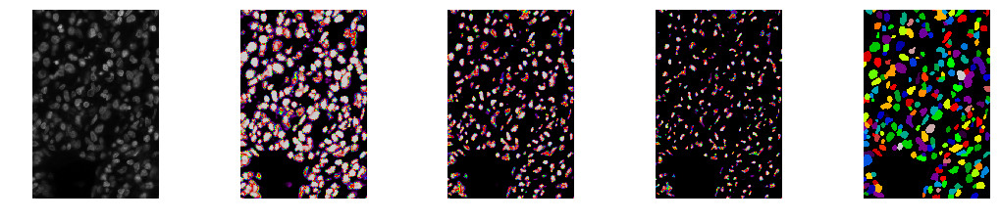

19


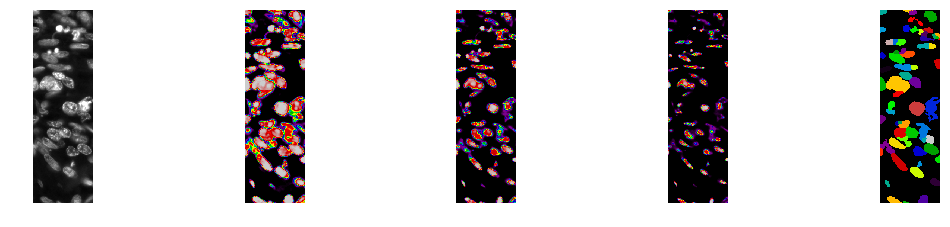

20


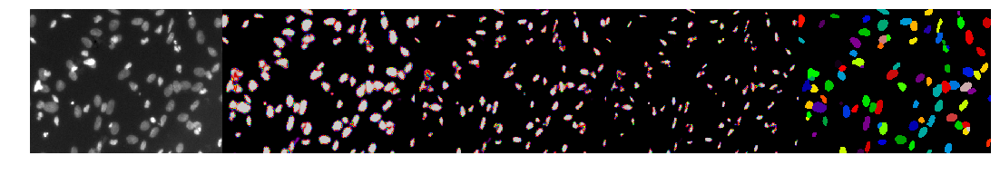

21


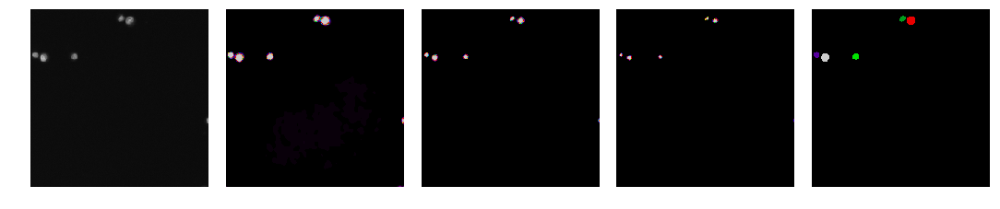

22


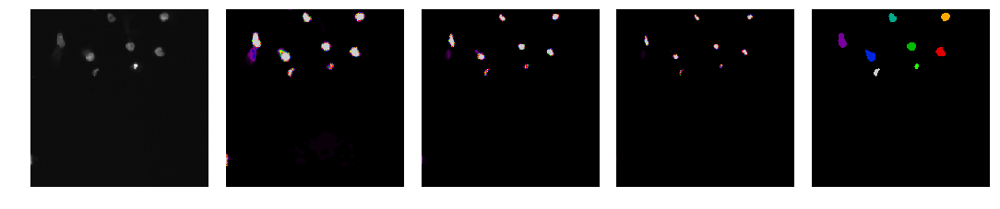

23


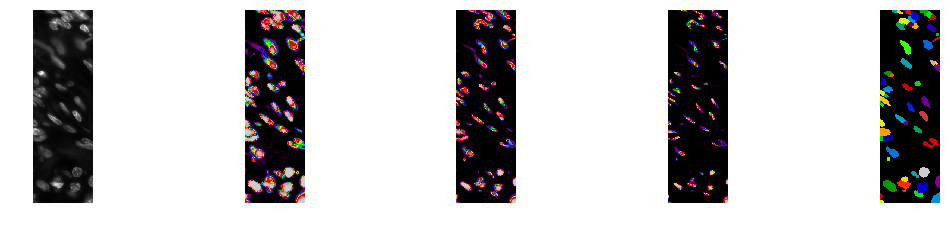

24


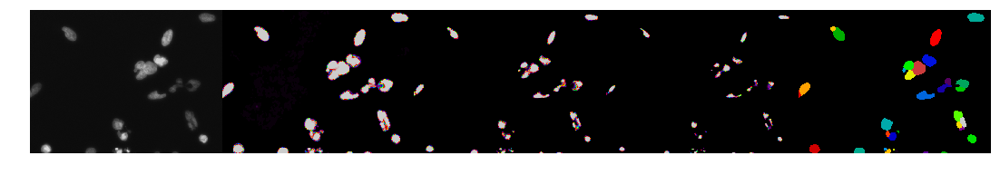

25


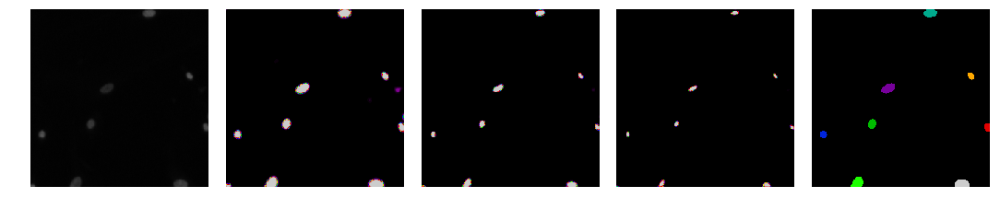

26


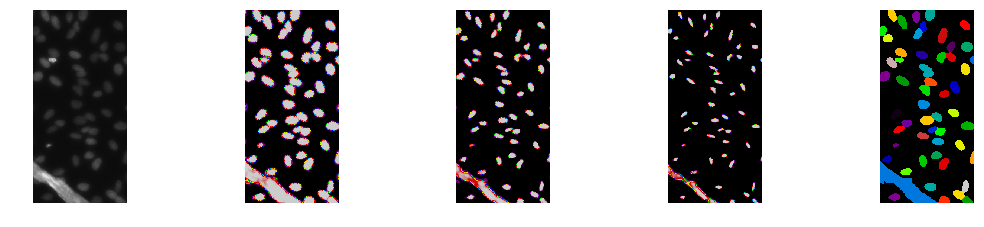

27


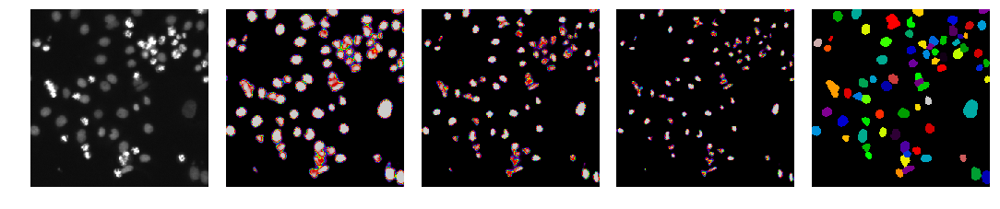

28


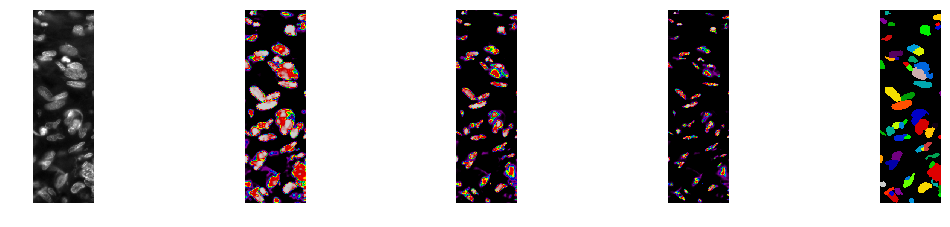

29


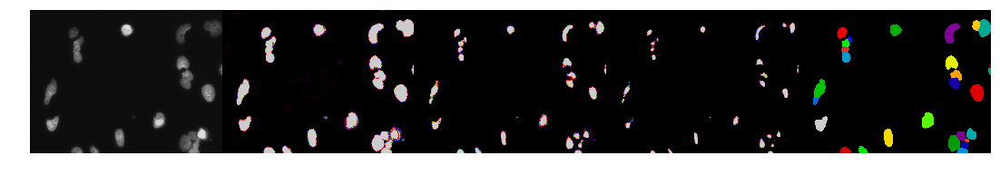

30


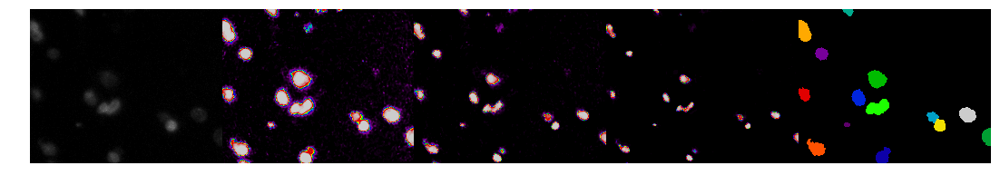

31


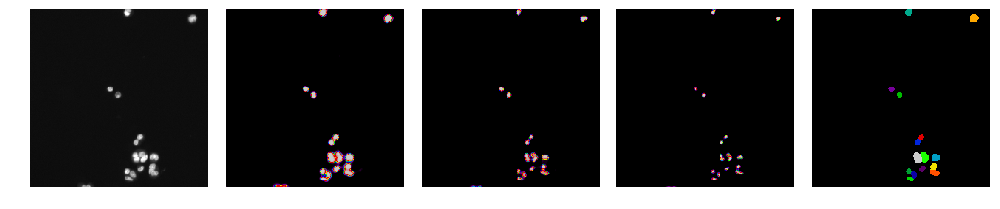

32


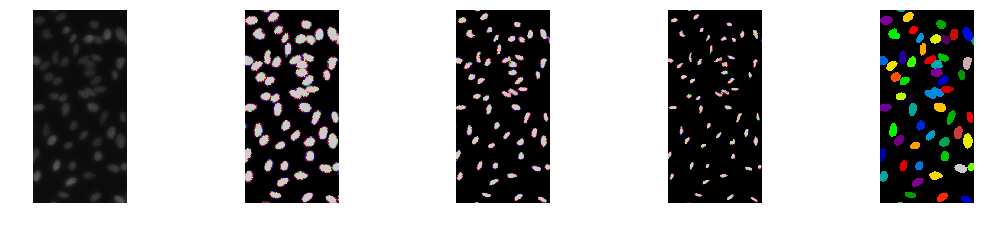

33


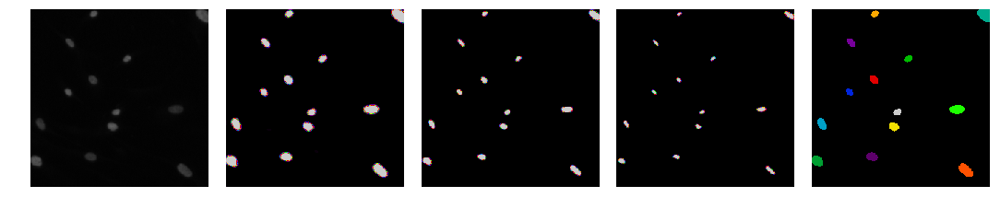

34


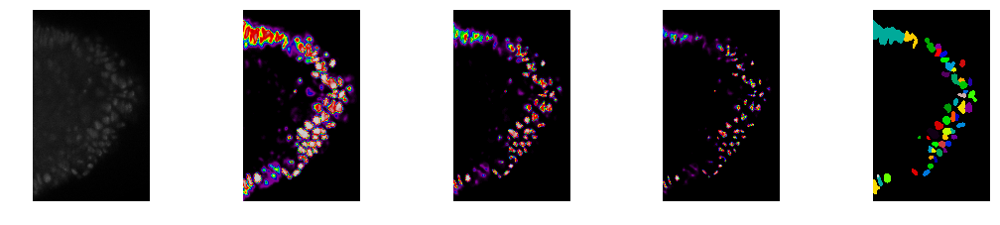

35


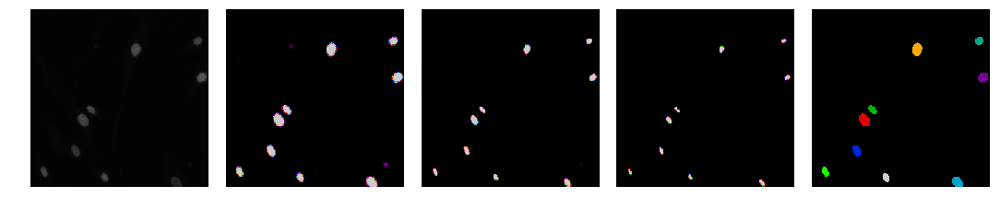

36


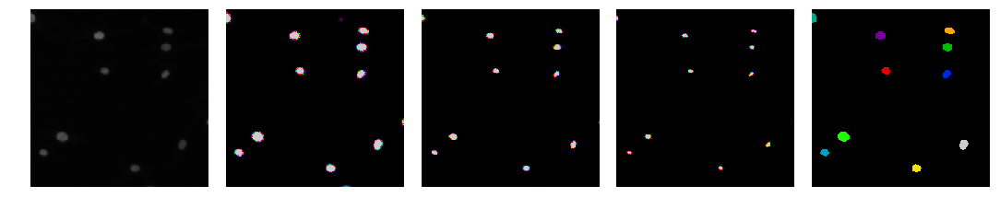

37


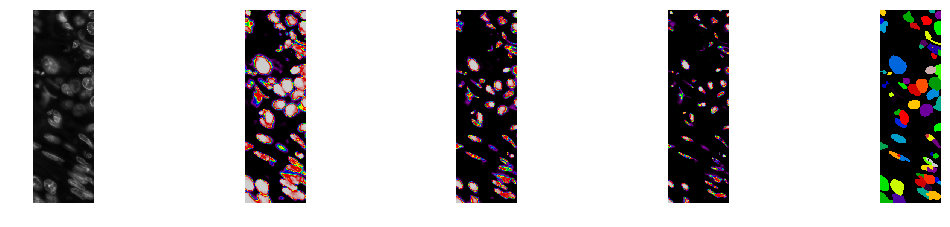

38


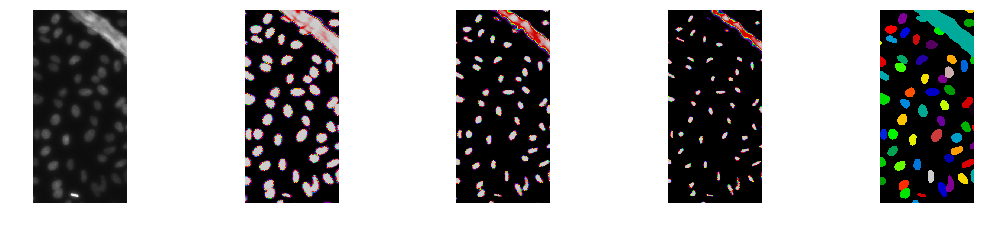

39


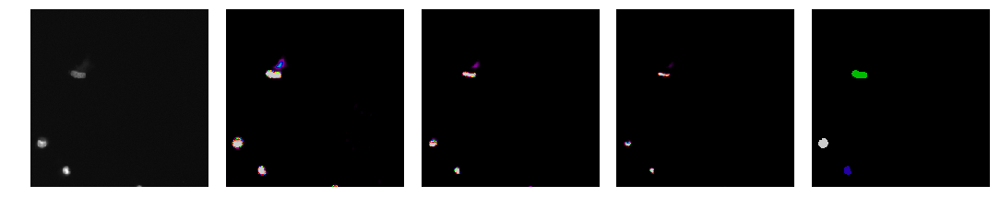

40


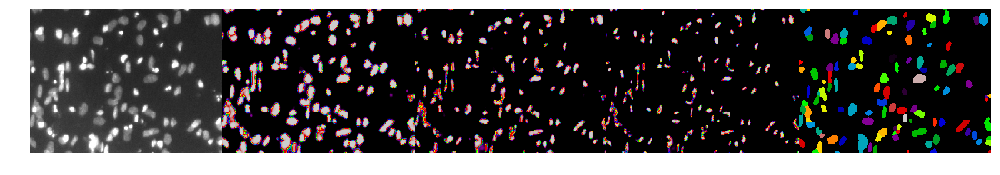

41


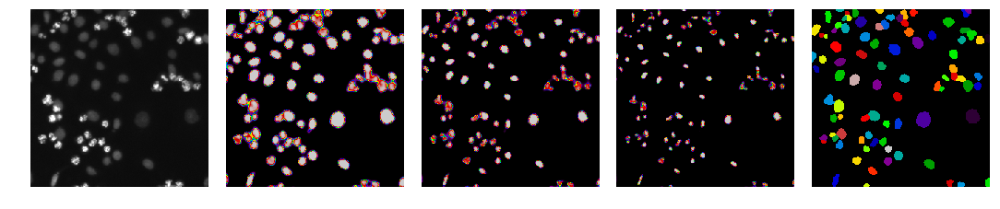

42


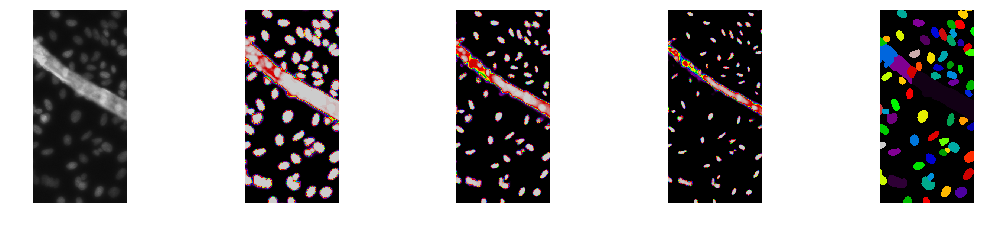

43


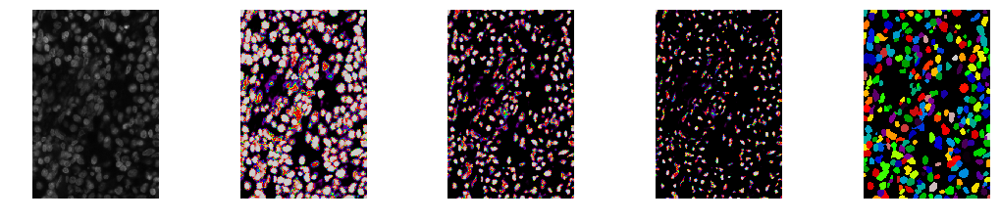

44


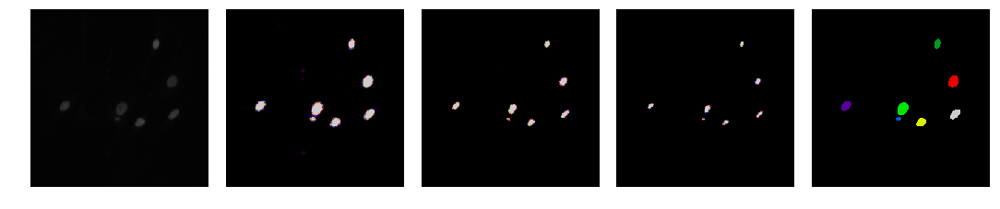

45


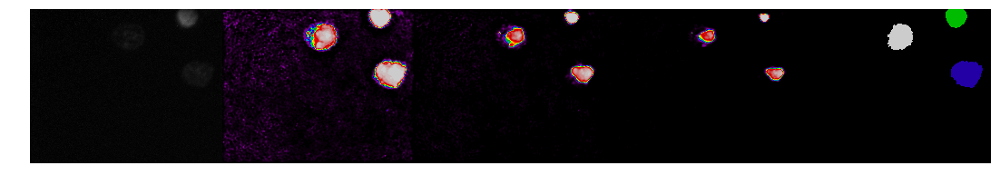

46


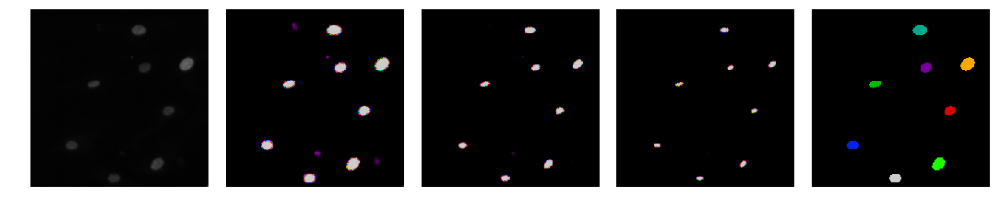

47


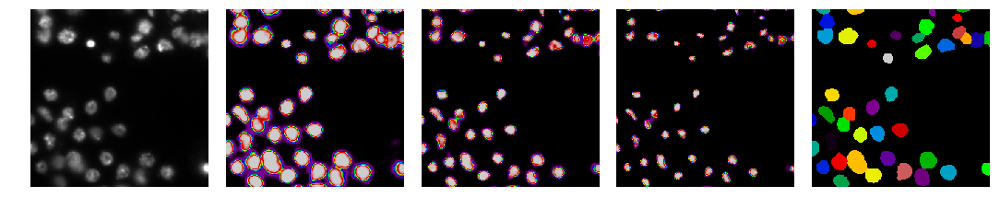

48


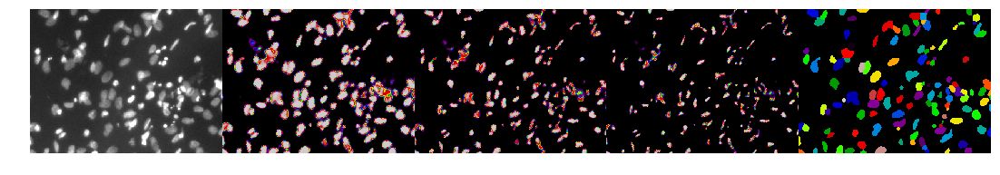

49


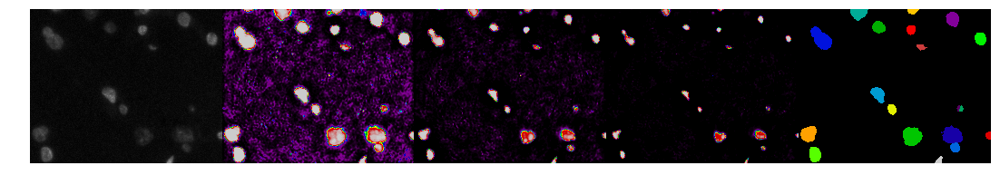

50


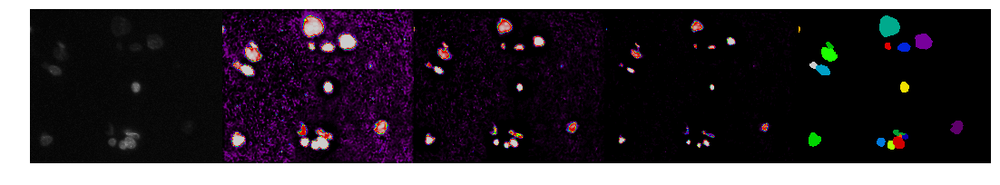

51


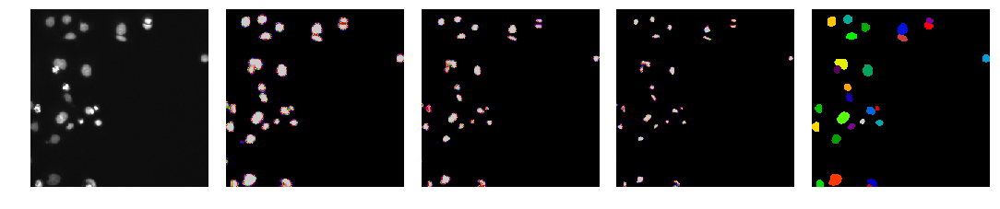

52


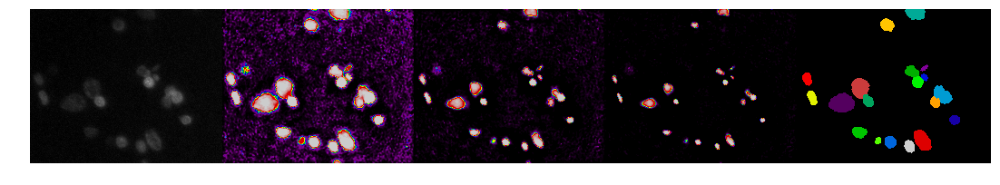

53


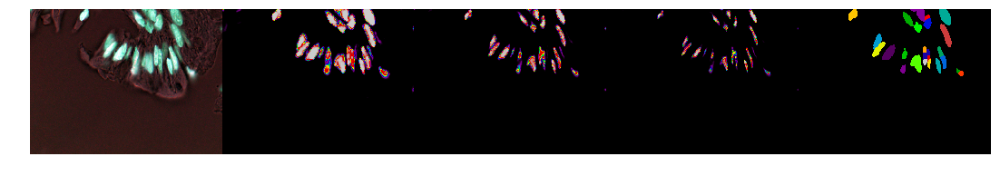

54


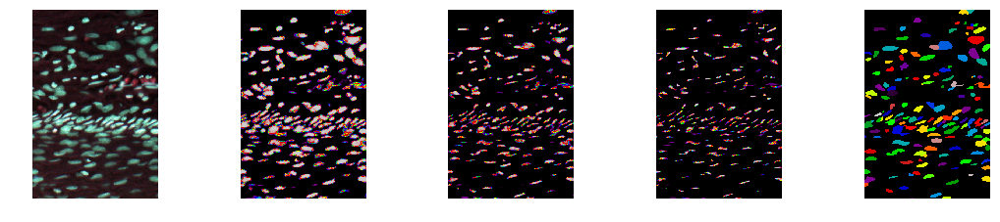

55


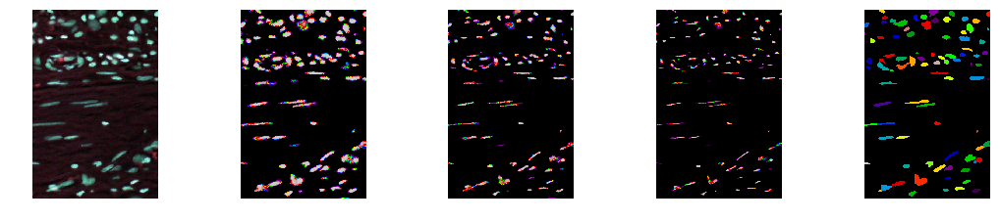

56


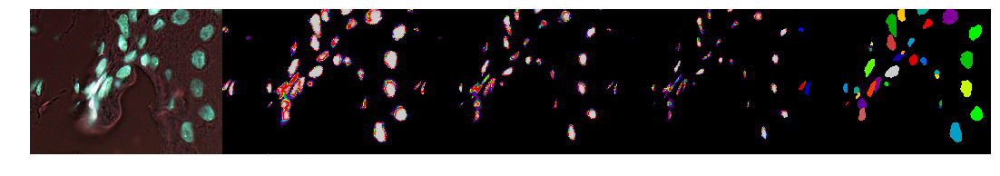

57


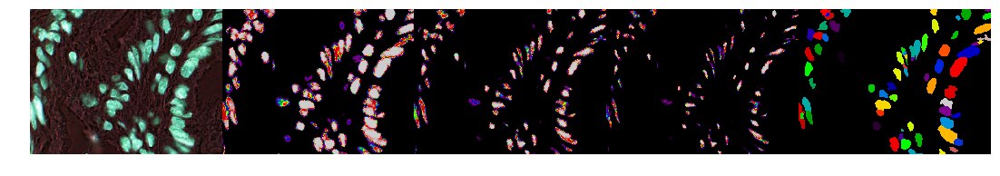

58


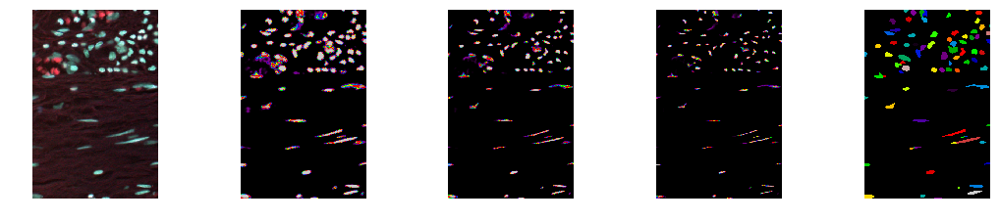

59


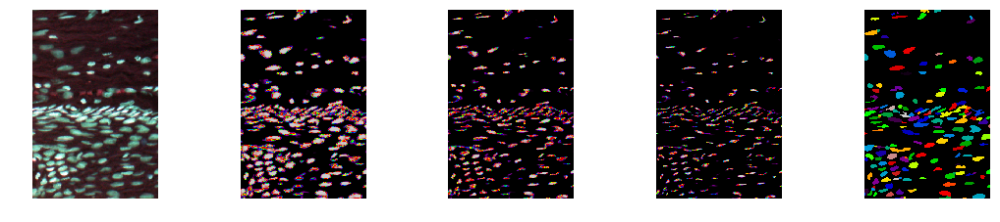

60


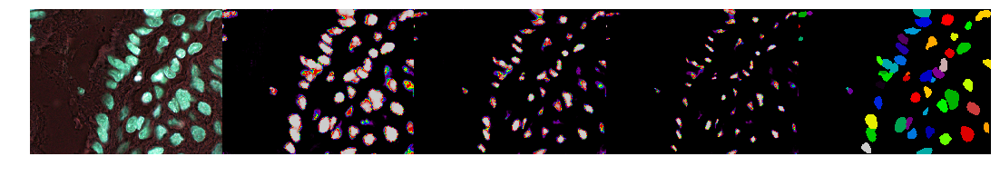

61


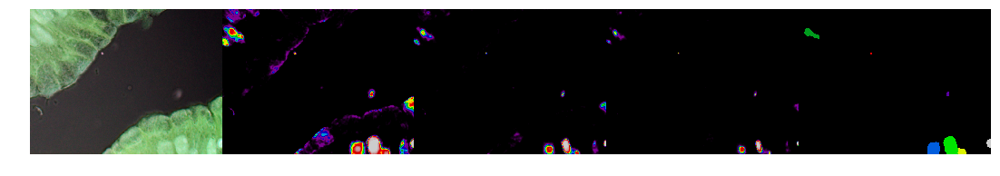

62


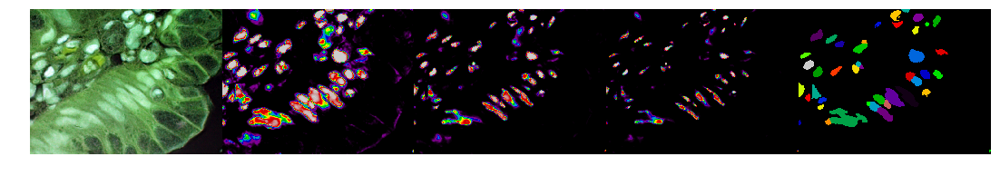

63


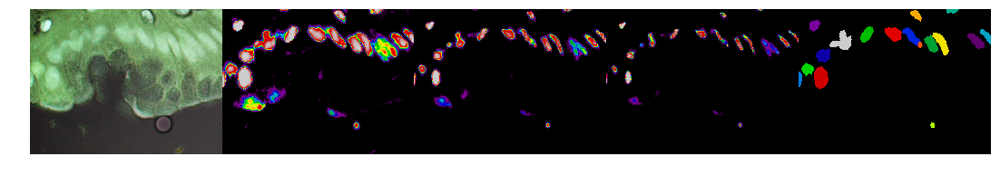

64


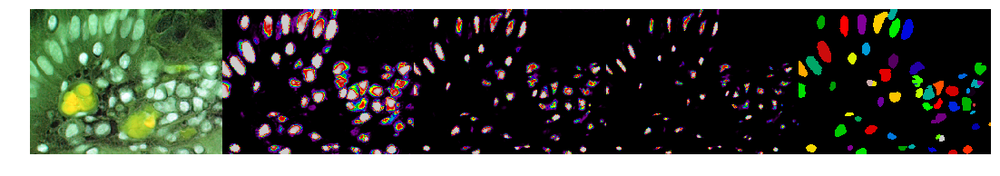

In [52]:
for i in range(len(test_images)):
    print(i)
    draw.plots([
      test_images[i],
      test_predictions[i][..., 0], 
      test_predictions[i][..., 1],
      test_predictions[i][..., 2],
      watershed(
        test_predictions[i], mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3))
    ) * 12367 % 1000,
    ], scale=3, col_number=5)
    plt.show()

In [53]:
new_ids, rles = utils.mask2rle(test_predictions, test_names, lambda x: watershed(
        x, mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3))
))

100%|██████████| 65/65 [00:02<00:00, 22.59it/s]


In [54]:
from datetime import datetime
sub = utils.make_submission(
    '../subs/{}.csv'.format(datetime.now()), new_ids, rles
)

In [367]:
sub.shape

(3349, 2)